# Food Delivery Dataset
Predict Whether delivery is on time or not: YES / NO, if on time then in how many minutes it taken? if late then how many minutes it late?

## Importing libraries

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

In [2]:
import warnings
warnings.filterwarnings("ignore")

## Load and Preview Dataset

### Train data

In [3]:
df_train = pd.read_csv("data/train.csv")
df_train.head()

,ID,Delivery_person_ID,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Order_Date,Time_Orderd,Time_Order_picked,Weatherconditions,Road_traffic_density,Vehicle_condition,Type_of_order,Type_of_vehicle,multiple_deliveries,Festival,City,Time_taken(min)
0,0x4607,INDORES13DEL02,37,4.9,22.745049,75.892471,22.765049,75.912471,19-03-2022,11:30:00,11:45:00,conditions Sunny,High,2,Snack,motorcycle,0,No,Urban,(min) 24
1,0xb379,BANGRES18DEL02,34,4.5,12.913041,77.683237,13.043041,77.813237,25-03-2022,19:45:00,19:50:00,conditions Stormy,Jam,2,Snack,scooter,1,No,Metropolitian,(min) 33
2,0x5d6d,BANGRES19DEL01,23,4.4,12.914264,77.678400,12.924264,77.688400,19-03-2022,8:30:00,8:45:00,conditions Sandstorms,Low,0,Drinks,motorcycle,1,No,Urban,(min) 26
3,0x7a6a,COIMBRES13DEL02,38,4.7,11.003669,76.976494,11.053669,77.026494,5/4/2022,18:00:00,18:10:00,conditions Sunny,Medium,0,Buffet,motorcycle,1,No,Metropolitian,(min) 21
4,0x70a2,CHENRES12DEL01,32,4.6,12.972793,80.249982,13.012793,80.289982,26-03-2022,13:30:00,13:45:00,conditions Cloudy,High,1,Snack,scooter,1,No,Metropolitian,(min) 30


In [4]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45593 entries, 0 to 45592
Data columns (total 20 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   ID                           45593 non-null  object 
 1   Delivery_person_ID           45593 non-null  object 
 2   Delivery_person_Age          45593 non-null  object 
 3   Delivery_person_Ratings      45593 non-null  object 
 4   Restaurant_latitude          45593 non-null  float64
 5   Restaurant_longitude         45593 non-null  float64
 6   Delivery_location_latitude   45593 non-null  float64
 7   Delivery_location_longitude  45593 non-null  float64
 8   Order_Date                   45593 non-null  object 
 9   Time_Orderd                  45593 non-null  object 
 10  Time_Order_picked            45593 non-null  object 
 11  Weatherconditions            45593 non-null  object 
 12  Road_traffic_density         45593 non-null  object 
 13  Vehicle_conditio

In [5]:
df_train.describe().T

,count,mean,std,min,25%,50%,75%,max
Restaurant_latitude,45593.0,17.017729,8.185109,-30.905562,12.933284,18.546947,22.728163,30.914057
Restaurant_longitude,45593.0,70.231332,22.883647,-88.366217,73.170000,75.898497,78.044095,88.433452
Delivery_location_latitude,45593.0,17.465186,7.335122,0.010000,12.988453,18.633934,22.785049,31.054057
Delivery_location_longitude,45593.0,70.845702,21.118812,0.010000,73.280000,76.002574,78.107044,88.563452
Vehicle_condition,45593.0,1.023359,0.839065,0.000000,0.000000,1.000000,2.000000,3.000000


In [6]:
df_train.describe(exclude=['int64', 'float64']).T

,count,unique,top,freq
ID,45593,45593,0x5fb2,1
Delivery_person_ID,45593,1320,PUNERES01DEL01,67
Delivery_person_Age,45593,23,35,2262
Delivery_person_Ratings,45593,29,4.8,7148
Order_Date,45593,44,15-03-2022,1192
Time_Orderd,45593,177,NaN,1731
Time_Order_picked,45593,193,21:30:00,496
Weatherconditions,45593,7,conditions Fog,7654
Road_traffic_density,45593,5,Low,15477
Type_of_order,45593,4,Snack,11533


In [7]:
df_train.shape

(45593, 20)

In [8]:
df1 = df_train.copy()

### Test data

In [9]:
df_test = pd.read_csv("data/test.csv")
df_test

,ID,Delivery_person_ID,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Order_Date,Time_Orderd,Time_Order_picked,Weatherconditions,Road_traffic_density,Vehicle_condition,Type_of_order,Type_of_vehicle,multiple_deliveries,Festival,City
0,0x2318,COIMBRES13DEL01,NaN,NaN,11.003669,76.976494,11.043669,77.016494,30-03-2022,NaN,15:05:00,conditions NaN,NaN,3,Drinks,electric_scooter,1,No,Metropolitian
1,0x3474,BANGRES15DEL01,28,4.6,12.975377,77.696664,13.085377,77.806664,29-03-2022,20:30:00,20:35:00,conditions Windy,Jam,0,Snack,motorcycle,1,No,Metropolitian
2,0x9420,JAPRES09DEL03,23,4.5,26.911378,75.789034,27.001378,75.879034,10-03-2022,19:35:00,19:45:00,conditions Stormy,Jam,0,Drinks,motorcycle,1,No,Metropolitian
3,0x72ee,JAPRES07DEL03,21,4.8,26.766536,75.837333,26.856536,75.927333,02-04-2022,17:15:00,17:20:00,conditions Fog,Medium,1,Meal,scooter,1,No,Metropolitian
4,0xa759,CHENRES19DEL01,31,4.6,12.986047,80.218114,13.096047,80.328114,27-03-2022,18:25:00,18:40:00,conditions Sunny,Medium,2,Drinks,scooter,1,No,Metropolitian
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11394,0x6909,JAPRES01DEL01,35,4.6,26.905190,75.810753,27.015190,75.920753,27-03-2022,21:35:00,21:45:00,conditions Sunny,Jam,1,Snack,scooter,1,No,Metropolitian
11395,0x443b,JAPRES11DEL01,33,4.9,26.902940,75.793007,26.912940,75.803007,11-03-2022,11:40:00,11:45:00,conditions Sandstorms,High,1,Drinks,scooter,1,No,Metropolitian
11396,0x1ea5,SURRES11DEL03,NaN,NaN,21.157735,72.768778,21.217735,72.828778,11-03-2022,NaN,21:05:00,conditions NaN,NaN,3,Drinks,scooter,1,No,Metropolitian
11397,0x22d4,VADRES03DEL02,27,4.7,22.320000,73.170000,22.450000,73.300000,06-03-2022,18:35:00,18:40:00,conditions Sandstorms,Medium,0,Meal,motorcycle,0,No,Metropolitian


In [10]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11399 entries, 0 to 11398
Data columns (total 19 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   ID                           11399 non-null  object 
 1   Delivery_person_ID           11399 non-null  object 
 2   Delivery_person_Age          11399 non-null  object 
 3   Delivery_person_Ratings      11399 non-null  object 
 4   Restaurant_latitude          11399 non-null  float64
 5   Restaurant_longitude         11399 non-null  float64
 6   Delivery_location_latitude   11399 non-null  float64
 7   Delivery_location_longitude  11399 non-null  float64
 8   Order_Date                   11399 non-null  object 
 9   Time_Orderd                  11399 non-null  object 
 10  Time_Order_picked            11399 non-null  object 
 11  Weatherconditions            11399 non-null  object 
 12  Road_traffic_density         11399 non-null  object 
 13  Vehicle_conditio

In [11]:
df_test.describe().T

,count,mean,std,min,25%,50%,75%,max
Restaurant_latitude,11399.0,17.099934,8.193510,-30.902872,12.933284,18.551440,22.732225,30.914057
Restaurant_longitude,11399.0,70.399259,22.773144,-88.400467,73.170937,75.897429,78.045732,88.433452
Delivery_location_latitude,11399.0,17.569497,7.287440,0.010000,12.992532,18.643481,22.791226,31.054057
Delivery_location_longitude,11399.0,71.102187,20.693782,0.010000,73.771081,75.996959,78.109004,88.563452
Vehicle_condition,11399.0,1.031406,0.839599,0.000000,0.000000,1.000000,2.000000,3.000000


In [12]:
df_test.describe(exclude=['int64', 'float64']).T

,count,unique,top,freq
ID,11399,11399,0xb7be,1
Delivery_person_ID,11399,1297,MUMRES11DEL02,24
Delivery_person_Age,11399,23,30,579
Delivery_person_Ratings,11399,29,4.9,1863
Order_Date,11399,44,01-04-2022,307
Time_Orderd,11399,177,NaN,444
Time_Order_picked,11399,193,19:25:00,133
Weatherconditions,11399,7,conditions Sunny,1975
Road_traffic_density,11399,5,Low,3881
Type_of_order,11399,4,Drinks,2920


In [13]:
df_test.shape

(11399, 19)

In [14]:
df2 = df_test.copy()

## Data Cleaning

### Finding Duplicates

In [15]:
df1.duplicated().any()

np.False_

In [16]:
df2.duplicated().any()

np.False_

**no duplicated records**

### Data Extraction
- Dropping 'ID' column as it is unnecessary
- Removing (min) word from 'Time_taken(min)' and make dtype int
- Removing conditions word from 'Weatherconditions' as it is unnecessary and make it more readable

In [17]:
from pipeline.data_cleaning import clean_columns

In [18]:
# removing (min) word from values of 'Time_taken(min)' as it is unnecessary and for make dtype numerical
df1['Time_taken(minutes)'] = df1['Time_taken(min)'].apply(lambda x:x.replace("(min)", " ").strip())

# removing original column 'Time_taken(min)'
df1.drop("Time_taken(min)", axis=1, inplace=True)
df1['Time_taken(minutes)'][0]
df1['Time_taken(minutes)'] = df1['Time_taken(minutes)'].astype(int)

In [19]:
df1 = clean_columns(df1)
df1

,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Order_Date,Time_Orderd,Time_Order_picked,Weatherconditions,Road_traffic_density,Vehicle_condition,Type_of_order,Type_of_vehicle,multiple_deliveries,Festival,City,Time_taken(minutes)
0,37,4.9,22.745049,75.892471,22.765049,75.912471,19-03-2022,11:30:00,11:45:00,Sunny,High,2,Snack,motorcycle,0,No,Urban,24
1,34,4.5,12.913041,77.683237,13.043041,77.813237,25-03-2022,19:45:00,19:50:00,Stormy,Jam,2,Snack,scooter,1,No,Metropolitian,33
2,23,4.4,12.914264,77.678400,12.924264,77.688400,19-03-2022,8:30:00,8:45:00,Sandstorms,Low,0,Drinks,motorcycle,1,No,Urban,26
3,38,4.7,11.003669,76.976494,11.053669,77.026494,5/4/2022,18:00:00,18:10:00,Sunny,Medium,0,Buffet,motorcycle,1,No,Metropolitian,21
4,32,4.6,12.972793,80.249982,13.012793,80.289982,26-03-2022,13:30:00,13:45:00,Cloudy,High,1,Snack,scooter,1,No,Metropolitian,30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45588,30,4.8,26.902328,75.794257,26.912328,75.804257,24-03-2022,11:35:00,11:45:00,Windy,High,1,Meal,motorcycle,0,No,Metropolitian,32
45589,21,4.6,0.000000,0.000000,0.070000,0.070000,16-02-2022,19:55:00,20:10:00,Windy,Jam,0,Buffet,motorcycle,1,No,Metropolitian,36
45590,30,4.9,13.022394,80.242439,13.052394,80.272439,11/3/2022,23:50:00,0:05:00,Cloudy,Low,1,Drinks,scooter,0,No,Metropolitian,16
45591,20,4.7,11.001753,76.986241,11.041753,77.026241,7/3/2022,13:35:00,13:40:00,Cloudy,High,0,Snack,motorcycle,1,No,Metropolitian,26


In [20]:
df2 = clean_columns(df2)
df2

,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Order_Date,Time_Orderd,Time_Order_picked,Weatherconditions,Road_traffic_density,Vehicle_condition,Type_of_order,Type_of_vehicle,multiple_deliveries,Festival,City
0,NaN,NaN,11.003669,76.976494,11.043669,77.016494,30-03-2022,NaN,15:05:00,NaN,NaN,3,Drinks,electric_scooter,1,No,Metropolitian
1,28,4.6,12.975377,77.696664,13.085377,77.806664,29-03-2022,20:30:00,20:35:00,Windy,Jam,0,Snack,motorcycle,1,No,Metropolitian
2,23,4.5,26.911378,75.789034,27.001378,75.879034,10-03-2022,19:35:00,19:45:00,Stormy,Jam,0,Drinks,motorcycle,1,No,Metropolitian
3,21,4.8,26.766536,75.837333,26.856536,75.927333,02-04-2022,17:15:00,17:20:00,Fog,Medium,1,Meal,scooter,1,No,Metropolitian
4,31,4.6,12.986047,80.218114,13.096047,80.328114,27-03-2022,18:25:00,18:40:00,Sunny,Medium,2,Drinks,scooter,1,No,Metropolitian
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11394,35,4.6,26.905190,75.810753,27.015190,75.920753,27-03-2022,21:35:00,21:45:00,Sunny,Jam,1,Snack,scooter,1,No,Metropolitian
11395,33,4.9,26.902940,75.793007,26.912940,75.803007,11-03-2022,11:40:00,11:45:00,Sandstorms,High,1,Drinks,scooter,1,No,Metropolitian
11396,NaN,NaN,21.157735,72.768778,21.217735,72.828778,11-03-2022,NaN,21:05:00,NaN,NaN,3,Drinks,scooter,1,No,Metropolitian
11397,27,4.7,22.320000,73.170000,22.450000,73.300000,06-03-2022,18:35:00,18:40:00,Sandstorms,Medium,0,Meal,motorcycle,0,No,Metropolitian


In [21]:
df1.nunique(dropna=False)

Delivery_person_Age              23
Delivery_person_Ratings          29
Restaurant_latitude             657
Restaurant_longitude            518
Delivery_location_latitude     4373
Delivery_location_longitude    4373
Order_Date                       44
Time_Orderd                     177
Time_Order_picked               193
Weatherconditions                 7
Road_traffic_density              5
Vehicle_condition                 4
Type_of_order                     4
Type_of_vehicle                   4
multiple_deliveries               5
Festival                          3
City                              4
Time_taken(minutes)              45
dtype: int64

In [22]:
df2.nunique(dropna=False)

Delivery_person_Age              23
Delivery_person_Ratings          29
Restaurant_latitude             492
Restaurant_longitude            434
Delivery_location_latitude     3572
Delivery_location_longitude    3572
Order_Date                       44
Time_Orderd                     177
Time_Order_picked               193
Weatherconditions                 7
Road_traffic_density              5
Vehicle_condition                 4
Type_of_order                     4
Type_of_vehicle                   4
multiple_deliveries               5
Festival                          3
City                              4
dtype: int64

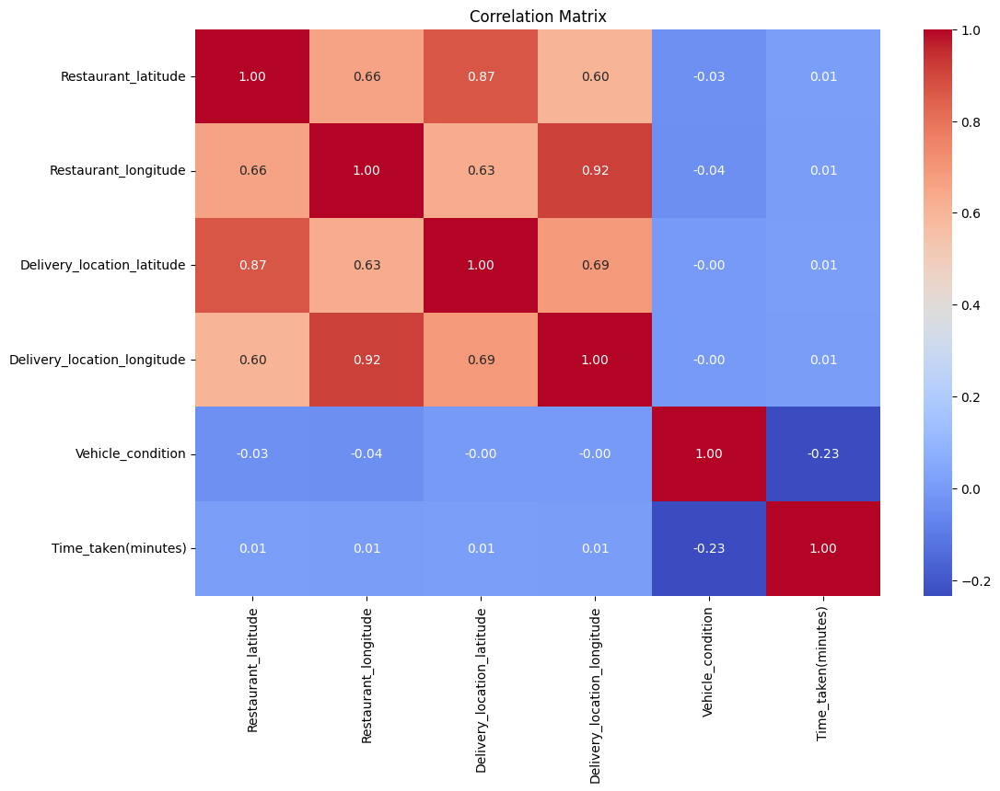

In [23]:
plt.figure(figsize=(12,8))
sns.heatmap(df1.corr(numeric_only=True), annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.show()

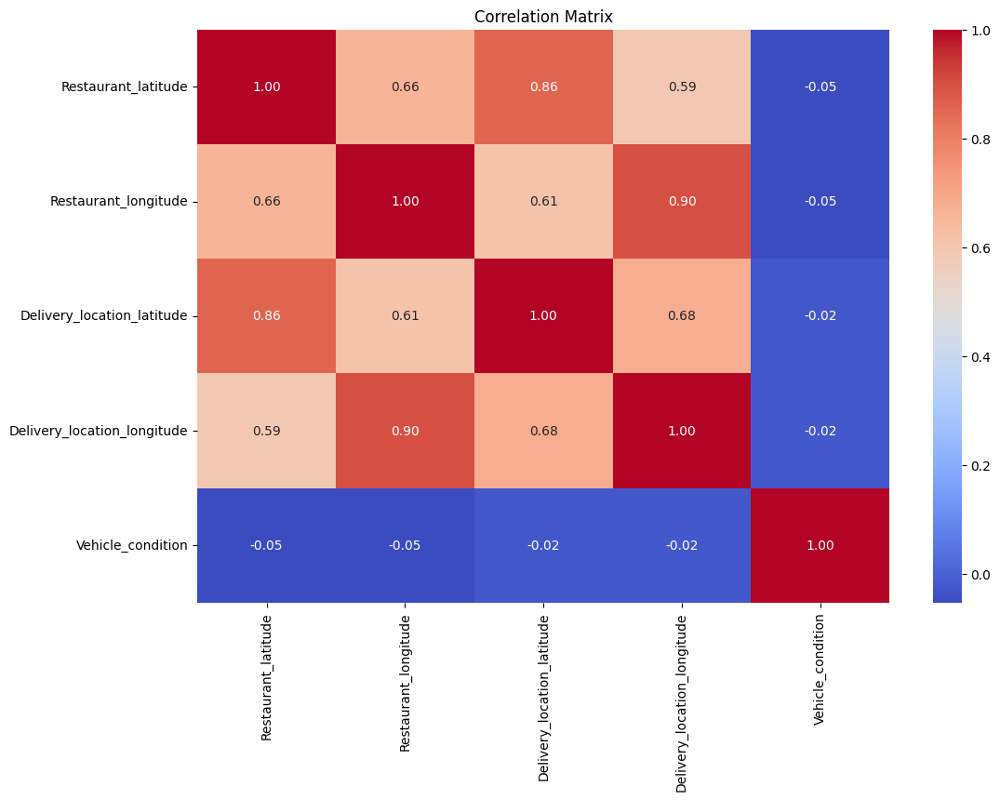

In [24]:
plt.figure(figsize=(12,8))
sns.heatmap(df2.corr(numeric_only=True), annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.show()

### Checking Missing values

In [25]:
df1['Type_of_vehicle'].value_counts()

Type_of_vehicle
motorcycle           26435
scooter              15276
electric_scooter      3814
bicycle                 68
Name: count, dtype: int64

In [26]:
df1['multiple_deliveries'].value_counts(dropna=False)

multiple_deliveries
1       28159
0       14095
2        1985
NaN       993
3         361
Name: count, dtype: int64

In [27]:
df1.iloc[42]['Delivery_person_Age']

'NaN '

In [28]:
from pipeline.data_cleaning import check_missing_values

In [29]:
df1 = check_missing_values(df1)

Delivery_person_Age            1854
Delivery_person_Ratings        1908
Restaurant_latitude               0
Restaurant_longitude              0
Delivery_location_latitude        0
Delivery_location_longitude       0
Order_Date                        0
Time_Orderd                    1731
Time_Order_picked                 0
Weatherconditions               616
Road_traffic_density            601
Vehicle_condition                 0
Type_of_order                     0
Type_of_vehicle                   0
multiple_deliveries             993
Festival                        228
City                           1200
Time_taken(minutes)               0
dtype: int64


In [30]:
df1.head()

,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Order_Date,Time_Orderd,Time_Order_picked,Weatherconditions,Road_traffic_density,Vehicle_condition,Type_of_order,Type_of_vehicle,multiple_deliveries,Festival,City,Time_taken(minutes)
0,37,4.9,22.745049,75.892471,22.765049,75.912471,19-03-2022,11:30:00,11:45:00,Sunny,High,2,Snack,motorcycle,0,No,Urban,24
1,34,4.5,12.913041,77.683237,13.043041,77.813237,25-03-2022,19:45:00,19:50:00,Stormy,Jam,2,Snack,scooter,1,No,Metropolitian,33
2,23,4.4,12.914264,77.678400,12.924264,77.688400,19-03-2022,8:30:00,8:45:00,Sandstorms,Low,0,Drinks,motorcycle,1,No,Urban,26
3,38,4.7,11.003669,76.976494,11.053669,77.026494,5/4/2022,18:00:00,18:10:00,Sunny,Medium,0,Buffet,motorcycle,1,No,Metropolitian,21
4,32,4.6,12.972793,80.249982,13.012793,80.289982,26-03-2022,13:30:00,13:45:00,Cloudy,High,1,Snack,scooter,1,No,Metropolitian,30


In [31]:
df2 = check_missing_values(df2)

Delivery_person_Age            491
Delivery_person_Ratings        507
Restaurant_latitude              0
Restaurant_longitude             0
Delivery_location_latitude       0
Delivery_location_longitude      0
Order_Date                       0
Time_Orderd                    444
Time_Order_picked                0
Weatherconditions              158
Road_traffic_density           154
Vehicle_condition                0
Type_of_order                    0
Type_of_vehicle                  0
multiple_deliveries            238
Festival                        65
City                           324
dtype: int64


In [32]:
df2.head()

,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Order_Date,Time_Orderd,Time_Order_picked,Weatherconditions,Road_traffic_density,Vehicle_condition,Type_of_order,Type_of_vehicle,multiple_deliveries,Festival,City
0,NaN,NaN,11.003669,76.976494,11.043669,77.016494,30-03-2022,NaN,15:05:00,NaN,NaN,3,Drinks,electric_scooter,1,No,Metropolitian
1,28,4.6,12.975377,77.696664,13.085377,77.806664,29-03-2022,20:30:00,20:35:00,Windy,Jam,0,Snack,motorcycle,1,No,Metropolitian
2,23,4.5,26.911378,75.789034,27.001378,75.879034,10-03-2022,19:35:00,19:45:00,Stormy,Jam,0,Drinks,motorcycle,1,No,Metropolitian
3,21,4.8,26.766536,75.837333,26.856536,75.927333,02-04-2022,17:15:00,17:20:00,Fog,Medium,1,Meal,scooter,1,No,Metropolitian
4,31,4.6,12.986047,80.218114,13.096047,80.328114,27-03-2022,18:25:00,18:40:00,Sunny,Medium,2,Drinks,scooter,1,No,Metropolitian


**Missing values in following columns**

- Delivery_person_Age = Numerical
- Delivery_person_Ratings = Numerical
- multiple_deliveries = numerical
- Weatherconditions = categorical
- Road_traffic_density = categorical
- Festival = categorical
- City = categorical
- Time_Orderd = time

### Updating dtypes of columns

In [33]:
from pipeline.data_cleaning import update_dtypes

In [34]:
df1 = update_dtypes(df1)
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45593 entries, 0 to 45592
Data columns (total 18 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   Delivery_person_Age          43739 non-null  float64       
 1   Delivery_person_Ratings      43685 non-null  float64       
 2   Restaurant_latitude          45593 non-null  float64       
 3   Restaurant_longitude         45593 non-null  float64       
 4   Delivery_location_latitude   45593 non-null  float64       
 5   Delivery_location_longitude  45593 non-null  float64       
 6   Order_Date                   45593 non-null  datetime64[ns]
 7   Time_Orderd                  43862 non-null  object        
 8   Time_Order_picked            45593 non-null  object        
 9   Weatherconditions            44977 non-null  object        
 10  Road_traffic_density         44992 non-null  object        
 11  Vehicle_condition            45593 non-nu

In [35]:
df2 = update_dtypes(df2)
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11399 entries, 0 to 11398
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   Delivery_person_Age          10908 non-null  float64       
 1   Delivery_person_Ratings      10892 non-null  float64       
 2   Restaurant_latitude          11399 non-null  float64       
 3   Restaurant_longitude         11399 non-null  float64       
 4   Delivery_location_latitude   11399 non-null  float64       
 5   Delivery_location_longitude  11399 non-null  float64       
 6   Order_Date                   11399 non-null  datetime64[ns]
 7   Time_Orderd                  10955 non-null  object        
 8   Time_Order_picked            11399 non-null  object        
 9   Weatherconditions            11241 non-null  object        
 10  Road_traffic_density         11245 non-null  object        
 11  Vehicle_condition            11399 non-nu

#### Checking Outliers in Columns containing missing values

In [36]:
from pipeline.eda import check_outliers_cols_missing_values

In [37]:
cols_exist_missing_values = ['Delivery_person_Age', 'Delivery_person_Ratings', 'Time_Orderd', 'Weatherconditions', 'Road_traffic_density', 'multiple_deliveries', 'Festival', 'City']

In [38]:
fig = check_outliers_cols_missing_values(df1, cols_exist_missing_values)
fig.show()

In [39]:
fig2 = check_outliers_cols_missing_values(df2, cols_exist_missing_values)
fig2.show()

### Handling missing values

**Imputing missing value in 'Delivery_person_Ratings'**

In [40]:
print(df1['Delivery_person_Ratings'].value_counts())
print(df2['Delivery_person_Ratings'].value_counts())

Delivery_person_Ratings
4.8    7148
4.7    7142
4.9    7041
4.6    6940
5.0    3996
4.5    3303
4.1    1430
4.2    1418
4.3    1409
4.4    1361
4.0    1077
3.5     249
3.8     228
3.7     225
3.6     207
3.9     197
6.0      53
1.0      38
3.4      32
3.1      29
3.2      29
3.3      25
2.6      22
2.7      22
2.5      20
2.8      19
2.9      19
3.0       6
Name: count, dtype: int64
Delivery_person_Ratings
4.9    1863
4.8    1790
4.7    1723
4.6    1663
5.0     999
4.5     843
4.2     351
4.3     341
4.4     326
4.1     311
4.0     295
3.5      66
3.9      62
3.7      59
3.6      51
3.8      51
3.3      13
2.6      12
3.4      12
6.0      10
1.0       9
3.1       8
2.5       8
2.7       7
2.9       7
3.2       7
2.8       3
3.0       2
Name: count, dtype: int64


<Axes: xlabel='Delivery_person_Ratings', ylabel='Count'>

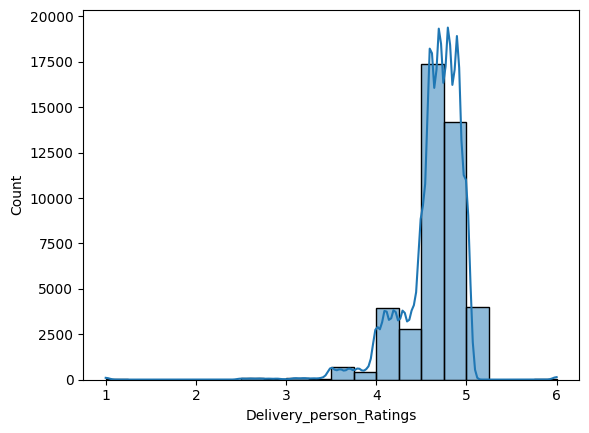

In [41]:
sns.histplot(df1['Delivery_person_Ratings'].dropna(), bins=20, kde=True)

<Axes: xlabel='Delivery_person_Ratings', ylabel='Count'>

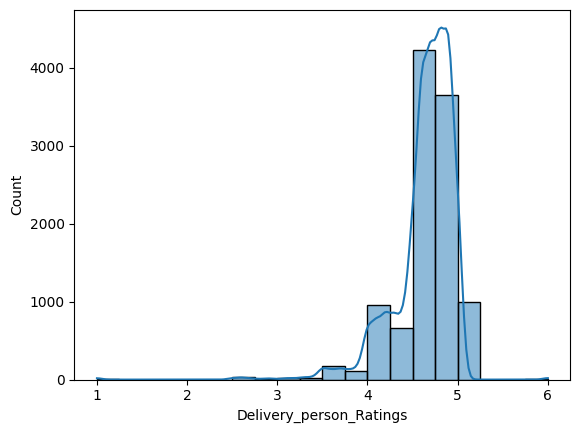

In [42]:
sns.histplot(df2['Delivery_person_Ratings'].dropna(), bins=20, kde=True)

In [43]:
# imputing with median as it is skewed data
median_imputation = df1['Delivery_person_Ratings'].fillna(df1['Delivery_person_Ratings'].median(), inplace=True)
median_imputation = df2['Delivery_person_Ratings'].fillna(df2['Delivery_person_Ratings'].median(), inplace=True)

In [44]:
print(df1['Delivery_person_Ratings'].isnull().sum())
print(df2['Delivery_person_Ratings'].isnull().sum())

0
0


<Axes: xlabel='Delivery_person_Ratings', ylabel='Count'>

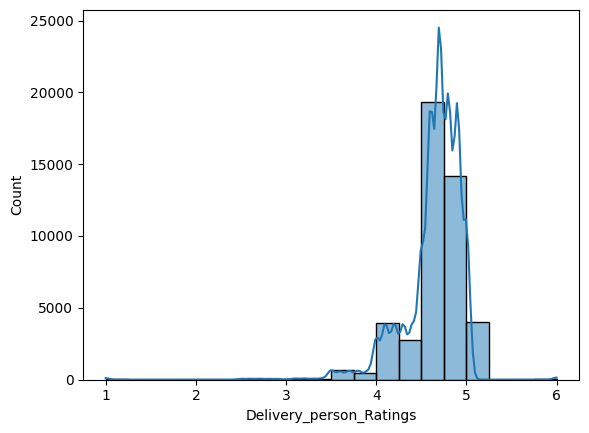

In [45]:
sns.histplot(df1['Delivery_person_Ratings'], bins=20, kde=True)

<Axes: xlabel='Delivery_person_Ratings', ylabel='Count'>

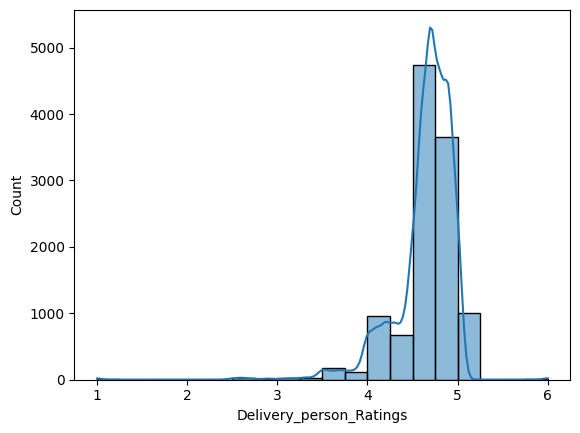

In [46]:
sns.histplot(df2['Delivery_person_Ratings'], bins=20, kde=True)

In [47]:
print(df1['Delivery_person_Ratings'].value_counts())
print(df2['Delivery_person_Ratings'].value_counts())

Delivery_person_Ratings
4.7    9050
4.8    7148
4.9    7041
4.6    6940
5.0    3996
4.5    3303
4.1    1430
4.2    1418
4.3    1409
4.4    1361
4.0    1077
3.5     249
3.8     228
3.7     225
3.6     207
3.9     197
6.0      53
1.0      38
3.4      32
3.1      29
3.2      29
3.3      25
2.6      22
2.7      22
2.5      20
2.8      19
2.9      19
3.0       6
Name: count, dtype: int64
Delivery_person_Ratings
4.7    2230
4.9    1863
4.8    1790
4.6    1663
5.0     999
4.5     843
4.2     351
4.3     341
4.4     326
4.1     311
4.0     295
3.5      66
3.9      62
3.7      59
3.6      51
3.8      51
3.3      13
2.6      12
3.4      12
6.0      10
1.0       9
3.1       8
2.5       8
2.7       7
2.9       7
3.2       7
2.8       3
3.0       2
Name: count, dtype: int64


- Delivery_person_age = numerical
- Weatherconditions = categorical
- Road_traffic_density = categorical
- Festival = categorical
- City = categorical
- multiple_deliveries = numerical

**Imputing missing value in 'Weatherconditions', 'Road_traffic_density', 'Festival', 'City' and  using most frequent value**

**Impute missing value in 'Delivery_person_Age' and 'multiple_deliveries' using KNNImputer**

In [48]:
columnss = ['Delivery_person_Age', 'multiple_deliveries']

histplot before imputing missing values with KNNImputer

<Axes: xlabel='Delivery_person_Age', ylabel='Count'>

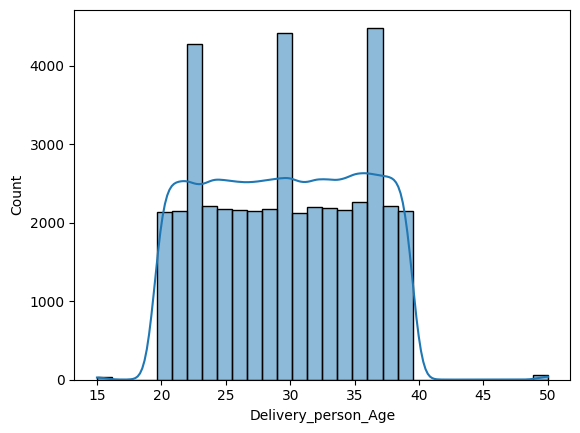

In [49]:
sns.histplot(data=df1, x='Delivery_person_Age', bins=30, kde=True)

<Axes: xlabel='Delivery_person_Age', ylabel='Count'>

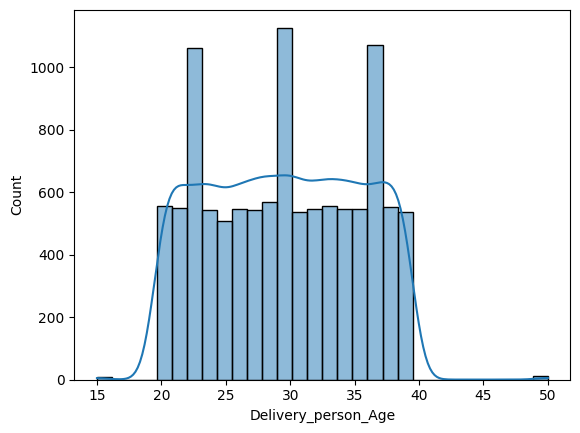

In [50]:
sns.histplot(data=df2, x='Delivery_person_Age', bins=30, kde=True)

<Axes: xlabel='multiple_deliveries', ylabel='Count'>

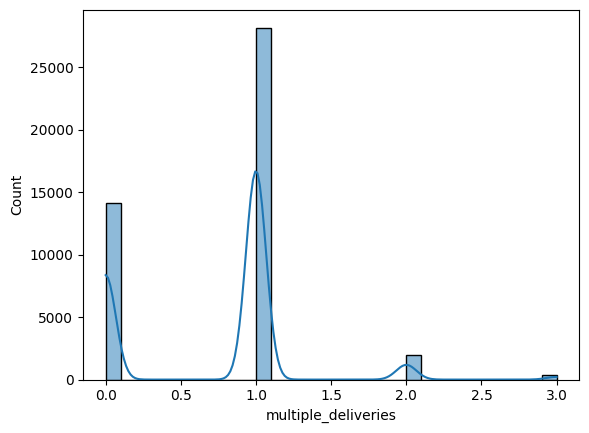

In [51]:
sns.histplot(data=df1, x='multiple_deliveries', bins=30, kde=True)

<Axes: xlabel='multiple_deliveries', ylabel='Count'>

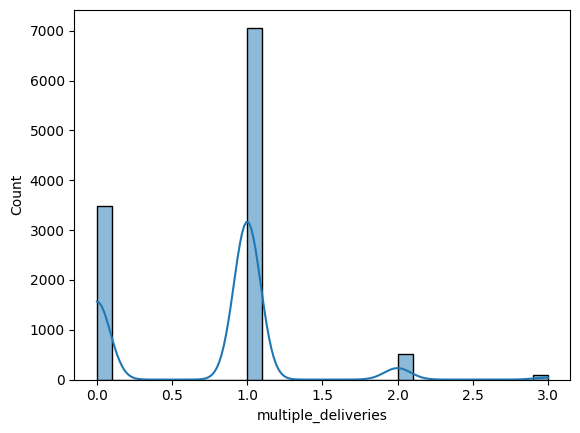

In [52]:
sns.histplot(data=df2, x='multiple_deliveries', bins=30, kde=True)

In [53]:
# value counts before imputation
# train data
print(df1['Delivery_person_Age'].value_counts())
print(df1['multiple_deliveries'].value_counts())

# test data
print(df2['Delivery_person_Age'].value_counts())
print(df2['multiple_deliveries'].value_counts())

Delivery_person_Age
35.0    2262
36.0    2260
37.0    2227
30.0    2226
38.0    2219
24.0    2210
32.0    2202
22.0    2196
29.0    2191
33.0    2187
28.0    2179
25.0    2174
34.0    2166
26.0    2159
21.0    2153
27.0    2150
39.0    2144
20.0    2136
31.0    2120
23.0    2087
50.0      53
15.0      38
Name: count, dtype: int64
multiple_deliveries
1.0    28159
0.0    14095
2.0     1985
3.0      361
Name: count, dtype: int64
Delivery_person_Age
30.0    579
28.0    569
33.0    556
20.0    555
38.0    551
21.0    549
37.0    549
29.0    548
34.0    547
35.0    547
26.0    545
32.0    545
24.0    544
27.0    543
23.0    541
39.0    536
31.0    535
22.0    522
36.0    521
25.0    507
50.0     10
15.0      9
Name: count, dtype: int64
multiple_deliveries
1.0    7065
0.0    3491
2.0     513
3.0      92
Name: count, dtype: int64


In [54]:
# filling missing values with knnimputer in 'Age' & 'multiple_deliveries' column
from sklearn.impute import KNNImputer

imputer = KNNImputer(n_neighbors=5)
df1[columnss] = imputer.fit_transform(df1[columnss])
df2[columnss] = imputer.transform(df2[columnss])

In [55]:
# Round the values in the specified columns to the nearest whole number
df1['Delivery_person_Age'] = df1['Delivery_person_Age'].round()
df1['multiple_deliveries'] = df1['multiple_deliveries'].round()
# converting dtype to integer
df1['Delivery_person_Age'] = df1['Delivery_person_Age'].astype(int)
df1['multiple_deliveries'] = df1['multiple_deliveries'].astype(int)
# print value counts
print(df1['Delivery_person_Age'].value_counts())
print(df1['multiple_deliveries'].value_counts())

Delivery_person_Age
30    4060
35    2262
36    2260
37    2227
38    2219
24    2210
32    2202
22    2196
29    2191
33    2187
28    2179
25    2174
34    2166
26    2159
21    2153
27    2150
39    2144
31    2140
20    2136
23    2087
50      53
15      38
Name: count, dtype: int64
multiple_deliveries
1    28913
0    14334
2     1985
3      361
Name: count, dtype: int64


In [56]:
# Round the values in the specified columns to the nearest whole number
df2['Delivery_person_Age'] = df2['Delivery_person_Age'].round()
df2['multiple_deliveries'] = df2['multiple_deliveries'].round()
# converting dtype to integer
df2['Delivery_person_Age'] = df2['Delivery_person_Age'].astype(int)
df2['multiple_deliveries'] = df2['multiple_deliveries'].astype(int)
# print value counts
print(df2['Delivery_person_Age'].value_counts())
print(df2['multiple_deliveries'].value_counts())

Delivery_person_Age
30    1068
28     569
33     556
20     555
38     551
21     549
37     549
29     548
34     547
35     547
26     545
32     545
24     544
27     543
23     541
31     537
39     536
22     522
36     521
25     507
50      10
15       9
Name: count, dtype: int64
multiple_deliveries
1    7241
0    3553
2     513
3      92
Name: count, dtype: int64


In [57]:
df1[columnss].isnull().sum()

Delivery_person_Age    0
multiple_deliveries    0
dtype: int64

histplot after imputing missing values with KNNImputer

<Axes: xlabel='Delivery_person_Age', ylabel='Count'>

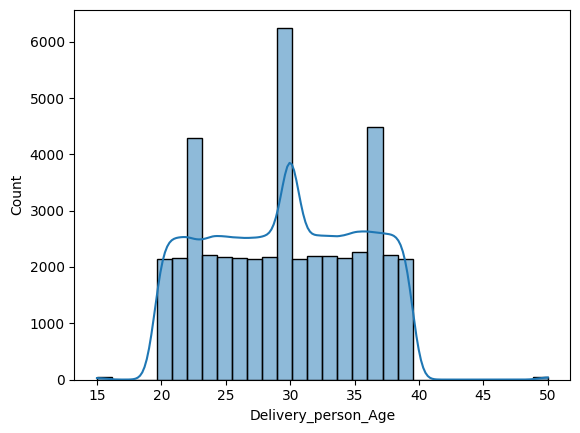

In [58]:
sns.histplot(data=df1, x='Delivery_person_Age', bins=30, kde=True)

<Axes: xlabel='Delivery_person_Age', ylabel='Count'>

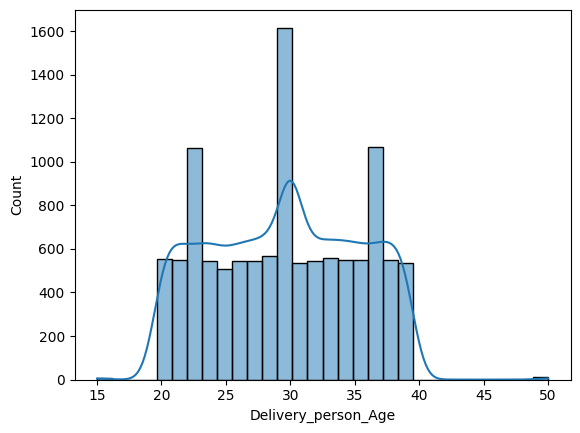

In [59]:
sns.histplot(data=df2, x='Delivery_person_Age', bins=30, kde=True)

<Axes: xlabel='multiple_deliveries', ylabel='Count'>

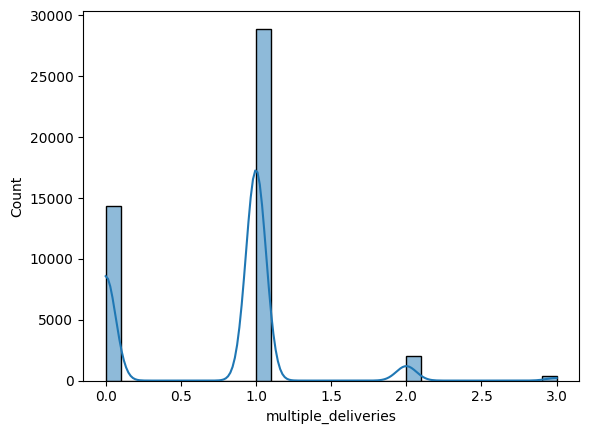

In [60]:
sns.histplot(data=df1, x='multiple_deliveries', bins=30, kde=True)

<Axes: xlabel='multiple_deliveries', ylabel='Count'>

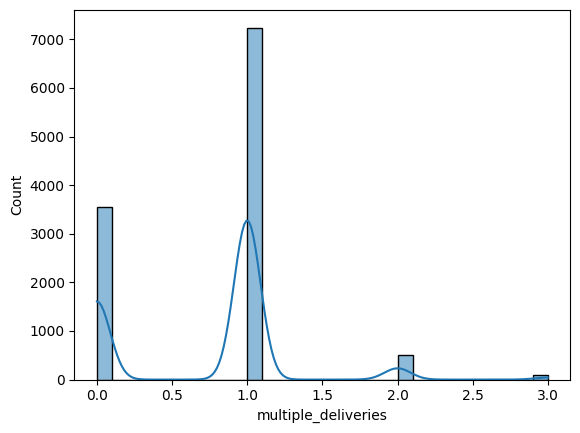

In [61]:
sns.histplot(data=df2, x='multiple_deliveries', bins=30, kde=True)

In [62]:
df1[columnss].head()

,Delivery_person_Age,multiple_deliveries
0,37,0
1,34,1
2,23,1
3,38,1
4,32,1


**fill missing values using mode**

In [63]:
missing_value_cols = ['Weatherconditions', 'Road_traffic_density', 'Festival', 'City']

In [64]:
# learning mode value from train data
modes_to_impute = {}

for col in missing_value_cols:
    print("\nValue counts before imputation on Train data:", df1[col].value_counts(dropna=False))
    print("\nValue counts before imputation on Test data:", df2[col].value_counts(dropna=False))
    mode_value = df1[col].mode()[0]
    modes_to_impute[col] = mode_value

print("\nModes learned from the training data:")
print(modes_to_impute)


Value counts before imputation on Train data: Weatherconditions
Fog           7654
Stormy        7586
Cloudy        7536
Sandstorms    7495
Windy         7422
Sunny         7284
NaN            616
Name: count, dtype: int64

Value counts before imputation on Test data: Weatherconditions
Sunny         1975
Windy         1948
Sandstorms    1878
Cloudy        1861
Stormy        1811
Fog           1768
NaN            158
Name: count, dtype: int64

Value counts before imputation on Train data: Road_traffic_density
Low        15477
Jam        14143
Medium     10947
High        4425
NaN          601
Name: count, dtype: int64

Value counts before imputation on Test data: Road_traffic_density
Low        3881
Jam        3503
Medium     2751
High       1110
NaN         154
Name: count, dtype: int64

Value counts before imputation on Train data: Festival
No      44469
Yes       896
NaN       228
Name: count, dtype: int64

Value counts before imputation on Test data: Festival
No      11131
Yes     

In [65]:
# used mode calculated from the training data to fill missing values in both train and test data
for col in missing_value_cols:
    df1[col].fillna(modes_to_impute[col], inplace=True)

for col in missing_value_cols:
    df2[col].fillna(modes_to_impute[col], inplace=True)

In [66]:
df1.isna().sum()

Delivery_person_Age               0
Delivery_person_Ratings           0
Restaurant_latitude               0
Restaurant_longitude              0
Delivery_location_latitude        0
Delivery_location_longitude       0
Order_Date                        0
Time_Orderd                    1731
Time_Order_picked                 0
Weatherconditions                 0
Road_traffic_density              0
Vehicle_condition                 0
Type_of_order                     0
Type_of_vehicle                   0
multiple_deliveries               0
Festival                          0
City                              0
Time_taken(minutes)               0
dtype: int64

In [67]:
df2.isna().sum()

Delivery_person_Age              0
Delivery_person_Ratings          0
Restaurant_latitude              0
Restaurant_longitude             0
Delivery_location_latitude       0
Delivery_location_longitude      0
Order_Date                       0
Time_Orderd                    444
Time_Order_picked                0
Weatherconditions                0
Road_traffic_density             0
Vehicle_condition                0
Type_of_order                    0
Type_of_vehicle                  0
multiple_deliveries              0
Festival                         0
City                             0
dtype: int64

**Imputing missing value in 'Time_Orderd'**

train data

In [68]:
from pipeline.data_cleaning import impute_order_time

In [69]:
df1 = impute_order_time(df1)

In [70]:
df1['Time_Orderd'] = df1['Time_Orderd_imputed']

In [71]:
drop_cols = ['Time_Orderd_min', 'Time_Order_picked_min', 'Time_Orderd_imputed_min', 'Time_Orderd_imputed']

In [72]:
df1.drop(drop_cols, axis=1, inplace=True)

In [73]:
print(df1.isnull().sum())

Delivery_person_Age            0
Delivery_person_Ratings        0
Restaurant_latitude            0
Restaurant_longitude           0
Delivery_location_latitude     0
Delivery_location_longitude    0
Order_Date                     0
Time_Orderd                    0
Time_Order_picked              0
Weatherconditions              0
Road_traffic_density           0
Vehicle_condition              0
Type_of_order                  0
Type_of_vehicle                0
multiple_deliveries            0
Festival                       0
City                           0
Time_taken(minutes)            0
dtype: int64


test data

In [74]:
df2 = impute_order_time(df2)

In [75]:
df2['Time_Orderd'] = df2['Time_Orderd_imputed']

In [76]:
df2.drop(drop_cols, axis=1, inplace=True)

In [77]:
df2.isnull().sum()

Delivery_person_Age            0
Delivery_person_Ratings        0
Restaurant_latitude            0
Restaurant_longitude           0
Delivery_location_latitude     0
Delivery_location_longitude    0
Order_Date                     0
Time_Orderd                    0
Time_Order_picked              0
Weatherconditions              0
Road_traffic_density           0
Vehicle_condition              0
Type_of_order                  0
Type_of_vehicle                0
multiple_deliveries            0
Festival                       0
City                           0
dtype: int64

### Categorical and Continuous features

In [78]:
df1.columns

Index(['Delivery_person_Age', 'Delivery_person_Ratings', 'Restaurant_latitude',
       'Restaurant_longitude', 'Delivery_location_latitude',
       'Delivery_location_longitude', 'Order_Date', 'Time_Orderd',
       'Time_Order_picked', 'Weatherconditions', 'Road_traffic_density',
       'Vehicle_condition', 'Type_of_order', 'Type_of_vehicle',
       'multiple_deliveries', 'Festival', 'City', 'Time_taken(minutes)'],
      dtype='object')

In [79]:
df2.columns

Index(['Delivery_person_Age', 'Delivery_person_Ratings', 'Restaurant_latitude',
       'Restaurant_longitude', 'Delivery_location_latitude',
       'Delivery_location_longitude', 'Order_Date', 'Time_Orderd',
       'Time_Order_picked', 'Weatherconditions', 'Road_traffic_density',
       'Vehicle_condition', 'Type_of_order', 'Type_of_vehicle',
       'multiple_deliveries', 'Festival', 'City'],
      dtype='object')

In [80]:
continuous_col = ['Delivery_person_Age', 'Delivery_person_Ratings', 'Vehicle_condition', 'multiple_deliveries']
categorical_col = ['Weatherconditions', 'Road_traffic_density', 'Type_of_order', 'Type_of_vehicle', 'Festival', 'City']
time_date_cols = ['Order_Date', 'Time_Orderd', 'Time_Order_picked', 'Time_taken(minutes)']
lat_lon_cols = ['Delivery_location_latitude', 'Delivery_location_longitude', 'Restaurant_latitude', 'Restaurant_longitude']

## Handling Outliers

### Handling Outliers in Continuous columns

In [81]:
from pipeline.eda import boxplot_num_cols

In [82]:
fig3 = boxplot_num_cols(df1, continuous_col)
fig3.show()

In [83]:
fig4 = boxplot_num_cols(df2, continuous_col)
fig4.show()

for train and test data we have outliers in Delivery_person_Age col and multiple_deliveries columns

In [84]:
df1['Delivery_person_Age'].value_counts()

Delivery_person_Age
30    4060
35    2262
36    2260
37    2227
38    2219
24    2210
32    2202
22    2196
29    2191
33    2187
28    2179
25    2174
34    2166
26    2159
21    2153
27    2150
39    2144
31    2140
20    2136
23    2087
50      53
15      38
Name: count, dtype: int64

In [85]:
df1['multiple_deliveries'].value_counts()
# so here value 3 is outlier, 0.8%

multiple_deliveries
1    28913
0    14334
2     1985
3      361
Name: count, dtype: int64

In [86]:
age_counts = df1['Delivery_person_Age'].value_counts().reset_index()
age_counts.columns = ['Age', 'Count']
px.bar(age_counts, x='Age', y='Count', width=800)

In [87]:
delivery_counts = df1['multiple_deliveries'].value_counts().reset_index()
delivery_counts.columns = ['Multiple_deliveries', 'Count']
px.bar(delivery_counts, x='Multiple_deliveries', y='Count', width=500)

In [88]:
from pipeline.data_cleaning import remove_outlier

In [89]:
df1 = remove_outlier(df1, 'Delivery_person_Age')

Old Shape (45593, 18)
Outlier Bounds for 'Delivery_person_Age':
  Lower Bound = 11.5
  Upper Bound = 47.5
Delivery_person_Age -> New Shape: (45540, 18)


In [90]:
df1 = remove_outlier(df1, 'multiple_deliveries')

Old Shape (45540, 18)
Outlier Bounds for 'multiple_deliveries':
  Lower Bound = -1.5
  Upper Bound = 2.5
multiple_deliveries -> New Shape: (45179, 18)


In [91]:
age_counts = df1['Delivery_person_Age'].value_counts().reset_index()
age_counts.columns = ['Age', 'Count']
px.bar(age_counts, x='Age', y='Count', width=800)

In [92]:
delivery_counts = df1['multiple_deliveries'].value_counts().reset_index()
delivery_counts.columns = ['Multiple_deliveries', 'Count']
px.bar(delivery_counts, x='Multiple_deliveries', y='Count', width=500)

test data

In [93]:
df2['multiple_deliveries'].value_counts()

multiple_deliveries
1    7241
0    3553
2     513
3      92
Name: count, dtype: int64

In [94]:
delivery_counts = df2['multiple_deliveries'].value_counts().reset_index()
delivery_counts.columns = ['Multiple_deliveries', 'Count']
px.bar(delivery_counts, x='Multiple_deliveries', y='Count', width=500)

In [95]:
df2 = remove_outlier(df2, 'multiple_deliveries')

Old Shape (11399, 17)
Outlier Bounds for 'multiple_deliveries':
  Lower Bound = -1.5
  Upper Bound = 2.5
multiple_deliveries -> New Shape: (11307, 17)


In [96]:
delivery_counts = df2['multiple_deliveries'].value_counts().reset_index()
delivery_counts.columns = ['Multiple_deliveries', 'Count']
px.bar(delivery_counts, x='Multiple_deliveries', y='Count', width=500)

In [97]:
df2['Delivery_person_Age'].value_counts()

Delivery_person_Age
30    1056
28     568
20     554
33     552
21     548
38     545
29     544
27     543
26     542
34     542
24     542
37     541
35     541
23     540
32     536
31     528
39     527
22     520
36     514
25     505
50      10
15       9
Name: count, dtype: int64

In [98]:
age_counts = df2['Delivery_person_Age'].value_counts().reset_index()
age_counts.columns = ['Age', 'Count']
px.bar(age_counts, x='Age', y='Count', width=800)

In [99]:
df2 = remove_outlier(df2, 'Delivery_person_Age')

Old Shape (11307, 17)
Outlier Bounds for 'Delivery_person_Age':
  Lower Bound = 11.5
  Upper Bound = 47.5
Delivery_person_Age -> New Shape: (11297, 17)


In [100]:
df2['Delivery_person_Age'].value_counts()

Delivery_person_Age
30    1056
28     568
20     554
33     552
21     548
38     545
29     544
27     543
34     542
26     542
24     542
35     541
37     541
23     540
32     536
31     528
39     527
22     520
36     514
25     505
15       9
Name: count, dtype: int64

In [101]:
age_counts = df2['Delivery_person_Age'].value_counts().reset_index()
age_counts.columns = ['Age', 'Count']
px.bar(age_counts, x='Age', y='Count', width=800)

### Handling Outliers in latitude & longitude columns

In [102]:
from pipeline.eda import lat_long_plot

train data

In [103]:
lat_long_plot(df1,'Delivery_location_latitude','Delivery_location_longitude')

In [104]:
lat_long_plot(df1,'Restaurant_latitude','Restaurant_longitude')

test data

In [105]:
lat_long_plot(df2,'Delivery_location_latitude','Delivery_location_longitude')

In [106]:
lat_long_plot(df2,'Restaurant_latitude','Restaurant_longitude')

#### Valid Restaurant Latitude & Longitude which covers India and Peru (but only india is valid bcoz delivery location is in india)

In [107]:
# train data
india_mask = (
    (df1['Restaurant_latitude'] >= 6.0) & (df1['Restaurant_latitude'] <= 38.0) &
    (df1['Restaurant_longitude'] >= 68.0) & (df1['Restaurant_longitude'] <= 97.5)
)

peru_mask = (
    (df1['Restaurant_latitude'] >= -17.0) & (df1['Restaurant_latitude'] <= -10.0) &
    (df1['Restaurant_longitude'] >= -77.5) & (df1['Restaurant_longitude'] <= -70.0)
)

valid_mask_rs1 = india_mask     # valid mask is india mask because delivery location contains only india, so peru mask is invalid, see in graph
invalid_idx_rs1 = df1[~valid_mask_rs1].index
print(invalid_idx_rs1)

Index([   33,    52,    57,    59,    67,    68,    72,    73,    76,    81,
       ...
       45504, 45514, 45531, 45536, 45543, 45547, 45569, 45577, 45579, 45589],
      dtype='int64', length=4004)


In [108]:
peru_mask.value_counts()

False    45153
True        26
Name: count, dtype: int64

In [109]:
# test data
india_mask = (
    (df2['Restaurant_latitude'] >= 6.0) & (df2['Restaurant_latitude'] <= 38.0) &
    (df2['Restaurant_longitude'] >= 68.0) & (df2['Restaurant_longitude'] <= 97.5)
)

peru_mask = (
    (df2['Restaurant_latitude'] >= -17.0) & (df2['Restaurant_latitude'] <= -10.0) &
    (df2['Restaurant_longitude'] >= -77.5) & (df2['Restaurant_longitude'] <= -70.0)
)

valid_mask_rs2 = india_mask     # valid mask is india mask because delivery location contains only india, so peru mask is invalid, see in graph
invalid_idx_rs2 = df2[~valid_mask_rs2].index
print(invalid_idx_rs2)

Index([   11,    12,    43,    57,    66,    74,    79,    96,    99,   101,
       ...
       11301, 11304, 11307, 11337, 11355, 11356, 11367, 11383, 11391, 11393],
      dtype='int64', length=977)


#### Valid Delivery location Latitude & Longitude which covers India 

In [110]:
# train data
india_mask = (
    (df1['Delivery_location_latitude'] >= 6.0) & (df1['Delivery_location_latitude'] <= 38.0) &
    (df1['Delivery_location_longitude'] >= 68.0) & (df1['Delivery_location_longitude'] <= 97.5)
)

valid_mask_dl1 = india_mask
invalid_idx_dl1 = df1[~valid_mask_dl1].index
print(invalid_idx_dl1)

Index([   33,    52,    57,    59,    67,    68,    72,    73,    76,    81,
       ...
       45497, 45514, 45531, 45536, 45543, 45547, 45569, 45577, 45579, 45589],
      dtype='int64', length=3599)


In [111]:
# test data
india_mask = (
    (df2['Delivery_location_latitude'] >= 6.0) & (df2['Delivery_location_latitude'] <= 38.0) &
    (df2['Delivery_location_longitude'] >= 68.0) & (df2['Delivery_location_longitude'] <= 97.5)
)

valid_mask_dl2 = india_mask
invalid_idx_dl2 = df2[~valid_mask_dl2].index
print(invalid_idx_dl2)

Index([   11,    12,    43,    66,    74,    79,    96,    99,   102,   117,
       ...
       11297, 11301, 11304, 11307, 11355, 11356, 11367, 11383, 11391, 11393],
      dtype='int64', length=865)


In [112]:
# train data
overlap = invalid_idx_rs1.intersection(invalid_idx_dl1)
print(f"Overlap count: {len(overlap)}")

Overlap count: 3599


In [113]:
# test data
overlap = invalid_idx_rs2.intersection(invalid_idx_dl2)
print(f"Overlap count: {len(overlap)}")

Overlap count: 865


#### Dropping records which contain invalid latitude & longitude

train data

In [114]:
# Combine invalid indexes (union)
invalid_idx_all1 = invalid_idx_rs1.union(invalid_idx_dl1)

# Drop that records
print("Shape before dropping invalid latitude and longitude records",df1.shape)
df1.drop(index=invalid_idx_all1, inplace=True)
print(f"Total rows dropped due to bad lat/lon: {len(invalid_idx_all1)}")
print("Shape after dropping invalid latitude and longitude records", df1.shape)

Shape before dropping invalid latitude and longitude records (45179, 18)
Total rows dropped due to bad lat/lon: 4004
Shape after dropping invalid latitude and longitude records (41175, 18)


In [115]:
lat_long_plot(df1,'Delivery_location_latitude','Delivery_location_longitude')

In [116]:
lat_long_plot(df1,'Restaurant_latitude','Restaurant_longitude')

test data

In [117]:
# Combine invalid indexes (union)
invalid_idx_all2 = invalid_idx_rs2.union(invalid_idx_dl2)

# Drop that records
print("Shape before dropping invalid latitude and longitude records",df2.shape)
df2.drop(index=invalid_idx_all2, inplace=True)
print(f"Total rows dropped due to bad lat/lon: {len(invalid_idx_all2)}")
print("Shape after dropping invalid latitude and longitude records", df2.shape)

Shape before dropping invalid latitude and longitude records (11297, 17)
Total rows dropped due to bad lat/lon: 977
Shape after dropping invalid latitude and longitude records (10320, 17)


In [118]:
lat_long_plot(df2,'Delivery_location_latitude','Delivery_location_longitude')

In [119]:
lat_long_plot(df2,'Restaurant_latitude','Restaurant_longitude')

### Handling Outliers in Time-date columns

#### Validating 'Time_Orderd' and 'Time_Order_picked'

In [120]:
df1[['Time_Orderd', 'Time_Order_picked']].head()

,Time_Orderd,Time_Order_picked
0,11:30:00,11:45:00
1,19:45:00,19:50:00
2,08:30:00,8:45:00
3,18:00:00,18:10:00
4,13:30:00,13:45:00


In [121]:
df1[['Time_Orderd', 'Time_Order_picked']].tail()

,Time_Orderd,Time_Order_picked
45587,21:45:00,21:55:00
45588,11:35:00,11:45:00
45590,23:50:00,0:05:00
45591,13:35:00,13:40:00
45592,17:10:00,17:15:00


In [122]:
df2[['Time_Orderd', 'Time_Order_picked']].head(10)

,Time_Orderd,Time_Order_picked
0,16:03:00,15:05:00
1,20:30:00,20:35:00
2,19:35:00,19:45:00
3,17:15:00,17:20:00
4,18:25:00,18:40:00
5,09:45:00,09:55:00
6,10:00:00,10:05:00
7,18:00:00,18:05:00
8,21:30:00,21:45:00
9,20:45:00,20:55:00


In [123]:
df2[['Time_Orderd', 'Time_Order_picked']].tail(10)

,Time_Orderd,Time_Order_picked
11387,20:45:00,21:00:00
11388,23:25:00,23:30:00
11389,21:45:00,22:00:00
11390,22:35:00,22:50:00
11392,17:25:00,17:40:00
11394,21:35:00,21:45:00
11395,11:40:00,11:45:00
11396,20:25:00,21:05:00
11397,18:35:00,18:40:00
11398,22:20:00,22:25:00


In [124]:
from pipeline.data_cleaning import validating_time_data

In [125]:
df1 = validating_time_data(df1)

Time_Orderd          0
Time_Order_picked    0
dtype: int64


In [126]:
df2 = validating_time_data(df2)

Time_Orderd          0
Time_Order_picked    0
dtype: int64


<!--  this is wrong, plot order_date col using time series chart as sir said, u can't find wrong values in this using boxplot -->

Order_month
3     19856
2      6160
5      2145
1      2109
11     1835
6      1775
4      1772
12     1573
9      1082
7      1063
10      916
8       889
Name: count, dtype: int64


<Axes: xlabel='Order_month', ylabel='Count'>

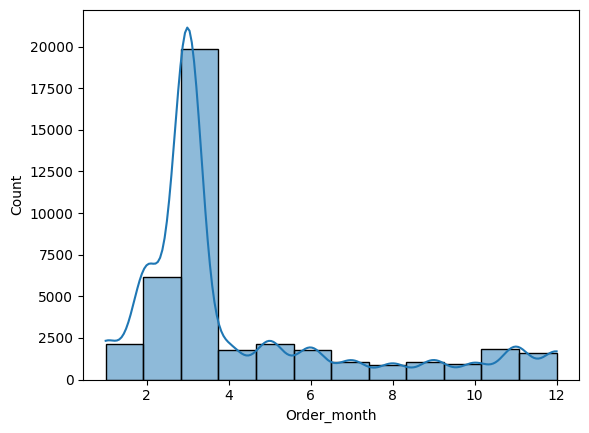

In [127]:
df1['Order_month'] = df1['Order_Date'].dt.month
print(df1['Order_month'].value_counts())
sns.histplot(data=df1, x='Order_month', kde=True, bins=12)

Order_month
3     4931
2     1530
1      565
5      526
4      475
6      463
11     455
12     410
7      272
9      257
8      231
10     205
Name: count, dtype: int64


<Axes: xlabel='Order_month', ylabel='Count'>

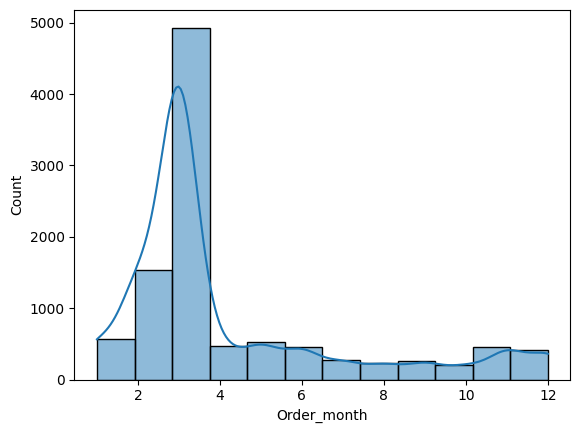

In [128]:
df2['Order_month'] = df2['Order_Date'].dt.month
print(df2['Order_month'].value_counts())
sns.histplot(data=df2, x='Order_month', kde=True, bins=12)

### Calculating Distance between resturant to delivery location and putting it into new feature 'Distance'

In [129]:
from pipeline.feature_engineering import calculate_dis

In [130]:
df1 = calculate_dis(df1)

In [131]:
df2 = calculate_dis(df2)

In [132]:
df1['Distance_in_km'].value_counts()

Distance_in_km
7     3747
1     3739
4     3697
10    3673
13    3592
3     3197
6     3192
9     3181
12    3161
16    2508
19    2438
20    1756
17    1153
11     532
2      525
5      515
8      509
14      60
Name: count, dtype: int64

In [133]:
df2['Distance_in_km'].value_counts()

Distance_in_km
4     947
10    920
13    916
1     912
7     889
9     803
12    799
6     798
3     786
19    628
16    625
20    429
17    304
8     146
5     144
2     134
11    125
14     15
Name: count, dtype: int64

### Handling Time data and Calculating Order_prepare_time

#### Detecting data where time_order_picked is less than time_orderd which is wrong data and Removing records which contains wrong time data

In [134]:
from pipeline.data_cleaning import detect_wrong_time_data

In [135]:
df1 = detect_wrong_time_data(df1)


wrong time data records
      Order_Date Time_Orderd Time_Order_picked
42    2022-06-04    18:40:00          18:35:00
74    2022-11-03    16:18:00          15:30:00
120   2022-02-04    18:28:00          18:25:00
179   2022-12-03    18:15:00          17:50:00
348   2022-02-03    05:19:00          00:05:00
...          ...         ...               ...
45343 2022-11-03    13:37:00          11:35:00
45360 2022-02-03    18:27:00          18:20:00
45518 2022-03-19    13:37:00          11:40:00
45519 2022-02-13    11:40:00          09:05:00
45566 2022-03-04    12:52:00          10:50:00

[580 rows x 3 columns]
index of wrong time data records Index([   42,    74,   120,   179,   348,   431,   507,   518,   605,   666,
       ...
       44869, 44881, 44945, 45031, 45288, 45343, 45360, 45518, 45519, 45566],
      dtype='int64', length=580)
Shape before dropping wrong time data (41175, 20)
Shape after dropping wrong time data (40595, 20)


In [136]:
df2 = detect_wrong_time_data(df2)


wrong time data records
      Order_Date Time_Orderd Time_Order_picked
0     2022-03-30    16:03:00          15:05:00
121   2022-05-03    13:30:00          11:35:00
154   2022-01-04    13:23:00          11:25:00
311   2022-06-04    05:11:00          00:10:00
360   2022-05-03    13:30:00          11:35:00
...          ...         ...               ...
11026 2022-02-03    18:36:00          18:35:00
11093 2022-03-15    11:30:00          08:50:00
11171 2022-03-13    17:38:00          17:15:00
11190 2022-11-02    13:26:00          11:30:00
11224 2022-03-21    13:37:00          11:45:00

[129 rows x 3 columns]
index of wrong time data records Index([    0,   121,   154,   311,   360,   371,   376,   443,   485,   662,
       ...
       10229, 10597, 10769, 10949, 11017, 11026, 11093, 11171, 11190, 11224],
      dtype='int64', length=129)
Shape before dropping wrong time data (10320, 19)
Shape after dropping wrong time data (10191, 19)


#### Calculate Order_prepare_time 

In [137]:
from pipeline.feature_engineering import calculate_time_diff

In [138]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40595 entries, 0 to 45592
Data columns (total 20 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   Delivery_person_Age          40595 non-null  int64         
 1   Delivery_person_Ratings      40595 non-null  float64       
 2   Restaurant_latitude          40595 non-null  float64       
 3   Restaurant_longitude         40595 non-null  float64       
 4   Delivery_location_latitude   40595 non-null  float64       
 5   Delivery_location_longitude  40595 non-null  float64       
 6   Order_Date                   40595 non-null  datetime64[ns]
 7   Time_Orderd                  40595 non-null  object        
 8   Time_Order_picked            40595 non-null  object        
 9   Weatherconditions            40595 non-null  object        
 10  Road_traffic_density         40595 non-null  object        
 11  Vehicle_condition            40595 non-null  i

In [139]:
df1 = calculate_time_diff(df1)
cols_to_drop = ['Time_Orderd_full', 'Time_Order_picked_full']
df1.drop(columns=cols_to_drop, axis=1, inplace=True)
df1[['Order_Date','Time_Orderd','Time_Order_picked', 'Order_prepare_time (minutes)']].head()

,Order_Date,Time_Orderd,Time_Order_picked,Order_prepare_time (minutes)
0,2022-03-19,11:30:00,11:45:00,15.0
1,2022-03-25,19:45:00,19:50:00,5.0
2,2022-03-19,08:30:00,08:45:00,15.0
3,2022-05-04,18:00:00,18:10:00,10.0
4,2022-03-26,13:30:00,13:45:00,15.0


In [140]:
df2 = calculate_time_diff(df2)
df2.drop(columns=cols_to_drop, axis=1, inplace=True)
df2[['Order_Date','Time_Orderd','Time_Order_picked', 'Order_prepare_time (minutes)']].head()

,Order_Date,Time_Orderd,Time_Order_picked,Order_prepare_time (minutes)
1,2022-03-29,20:30:00,20:35:00,5.0
2,2022-10-03,19:35:00,19:45:00,10.0
3,2022-02-04,17:15:00,17:20:00,5.0
4,2022-03-27,18:25:00,18:40:00,15.0
5,2022-02-15,09:45:00,09:55:00,10.0


Order_prepare_time (minutes)
5.0      13409
15.0     13258
10.0     13248
72.0        16
13.0        16
         ...  
90.0         2
102.0        1
59.0         1
47.0         1
100.0        1
Name: count, Length: 101, dtype: int64

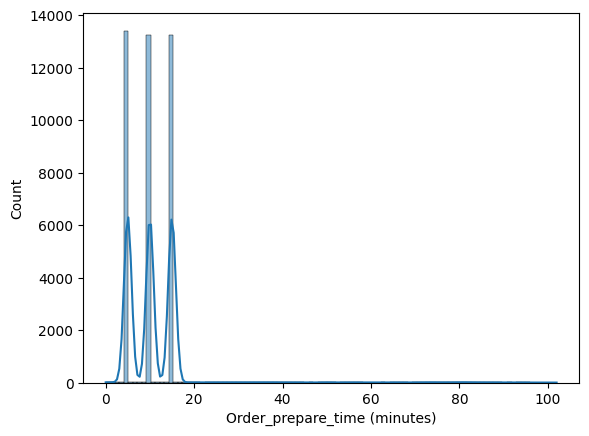

In [141]:
sns.histplot(data=df1, x='Order_prepare_time (minutes)', kde=True, bins=100)
df1['Order_prepare_time (minutes)'].value_counts()

Order_prepare_time (minutes)
15.0    3405
10.0    3323
5.0     3278
11.0       7
55.0       7
83.0       7
63.0       5
70.0       5
37.0       5
2.0        5
84.0       5
80.0       5
3.0        5
44.0       5
38.0       5
19.0       4
82.0       4
64.0       4
4.0        4
34.0       4
75.0       4
67.0       4
65.0       4
76.0       4
6.0        4
68.0       4
29.0       4
49.0       4
48.0       4
23.0       3
26.0       3
61.0       3
52.0       3
71.0       3
41.0       3
42.0       3
51.0       3
40.0       3
36.0       3
78.0       2
21.0       2
45.0       2
18.0       2
32.0       2
86.0       2
47.0       2
53.0       2
13.0       2
0.0        2
33.0       2
9.0        2
30.0       1
59.0       1
17.0       1
7.0        1
14.0       1
56.0       1
60.0       1
28.0       1
79.0       1
Name: count, dtype: int64

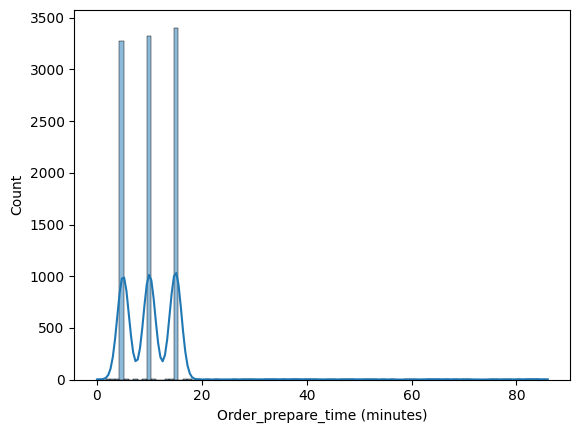

In [142]:
sns.histplot(data=df2, x='Order_prepare_time (minutes)', kde=True, bins=100)
df2['Order_prepare_time (minutes)'].value_counts()

In [143]:
px.box(data_frame=df1, x='Time_taken(minutes)')

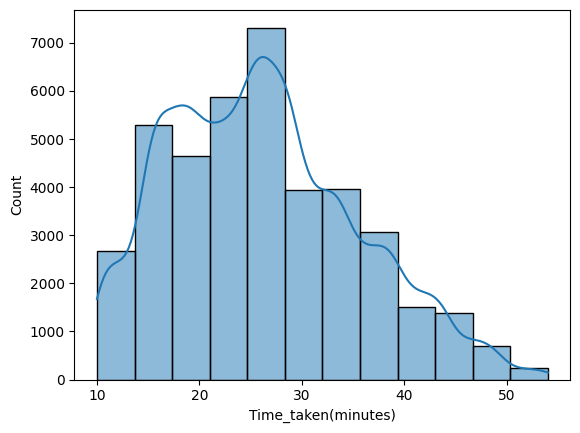

In [144]:
# px.bar(data_frame=df1, x='Time_taken(minutes)')
sns.histplot(data=df1, x='Time_taken(minutes)', kde=True, bins=12)
px.histogram(data_frame=df1, x='Time_taken(minutes)', nbins=55, width=500)

In [145]:
df1.drop('Order_month', axis=1, inplace=True)
df1.columns

Index(['Delivery_person_Age', 'Delivery_person_Ratings', 'Restaurant_latitude',
       'Restaurant_longitude', 'Delivery_location_latitude',
       'Delivery_location_longitude', 'Order_Date', 'Time_Orderd',
       'Time_Order_picked', 'Weatherconditions', 'Road_traffic_density',
       'Vehicle_condition', 'Type_of_order', 'Type_of_vehicle',
       'multiple_deliveries', 'Festival', 'City', 'Time_taken(minutes)',
       'Distance_in_km', 'Order_prepare_time (minutes)'],
      dtype='object')

In [146]:
df2.drop('Order_month', axis=1, inplace=True)
df2.columns

Index(['Delivery_person_Age', 'Delivery_person_Ratings', 'Restaurant_latitude',
       'Restaurant_longitude', 'Delivery_location_latitude',
       'Delivery_location_longitude', 'Order_Date', 'Time_Orderd',
       'Time_Order_picked', 'Weatherconditions', 'Road_traffic_density',
       'Vehicle_condition', 'Type_of_order', 'Type_of_vehicle',
       'multiple_deliveries', 'Festival', 'City', 'Distance_in_km',
       'Order_prepare_time (minutes)'],
      dtype='object')

### Handling Categorical Columns

In [147]:
time_date_cols

['Order_Date', 'Time_Orderd', 'Time_Order_picked', 'Time_taken(minutes)']

In [148]:
time_date_cols.append('Time_Orderd_full')
time_date_cols.append('Time_Order_picked_full')
continuous_col.append('Distance_in_km')

print(categorical_col)
print(lat_lon_cols)
print(continuous_col)
print(time_date_cols)

['Weatherconditions', 'Road_traffic_density', 'Type_of_order', 'Type_of_vehicle', 'Festival', 'City']
['Delivery_location_latitude', 'Delivery_location_longitude', 'Restaurant_latitude', 'Restaurant_longitude']
['Delivery_person_Age', 'Delivery_person_Ratings', 'Vehicle_condition', 'multiple_deliveries', 'Distance_in_km']
['Order_Date', 'Time_Orderd', 'Time_Order_picked', 'Time_taken(minutes)', 'Time_Orderd_full', 'Time_Order_picked_full']


In [149]:
categorical_col

['Weatherconditions',
 'Road_traffic_density',
 'Type_of_order',
 'Type_of_vehicle',
 'Festival',
 'City']

In [150]:
# train
for col in categorical_col:
    print(df1[col].value_counts())

Weatherconditions
Fog           7030
Stormy        6825
Cloudy        6737
Sandstorms    6733
Windy         6690
Sunny         6580
Name: count, dtype: int64
Road_traffic_density
Low        14128
Jam        12711
Medium      9827
High        3929
Name: count, dtype: int64
Type_of_order
Snack      10271
Meal       10157
Drinks     10136
Buffet     10031
Name: count, dtype: int64
Type_of_vehicle
motorcycle           23624
scooter              13645
electric_scooter      3301
bicycle                 25
Name: count, dtype: int64
Festival
No      39879
Yes       716
Name: count, dtype: int64
City
Metropolitian     31480
Urban              9007
Semi-Urban          108
Name: count, dtype: int64


In [151]:
# test
for col in categorical_col:
    print(df2[col].value_counts())

Weatherconditions
Sunny         1770
Windy         1737
Cloudy        1703
Sandstorms    1701
Fog           1646
Stormy        1634
Name: count, dtype: int64
Road_traffic_density
Low        3565
Jam        3157
Medium     2482
High        987
Name: count, dtype: int64
Type_of_order
Drinks     2607
Buffet     2583
Meal       2502
Snack      2499
Name: count, dtype: int64
Type_of_vehicle
motorcycle           5947
scooter              3414
electric_scooter      819
bicycle                11
Name: count, dtype: int64
Festival
No      10023
Yes       168
Name: count, dtype: int64
City
Metropolitian     7885
Urban             2272
Semi-Urban          34
Name: count, dtype: int64


In [152]:
from pipeline.eda import bar_plot_cat_cols

In [153]:
fig = bar_plot_cat_cols(df1, categorical_col)
fig.show()

In [154]:
fig1 = bar_plot_cat_cols(df2, categorical_col)
fig1.show()

##### Groupping values into Columns such as City, Type_of_vehicle

In [155]:
from pipeline.feature_engineering import handle_cat_cols

In [156]:
df1 = handle_cat_cols(df1)


Before Grouping

Original 'City' counts:
City
Metropolitian     31480
Urban              9007
Semi-Urban          108
Name: count, dtype: int64


After Grouping

'City' counts after merging 'Semi-Urban':
City
Metropolitian    31480
Urban             9115
Name: count, dtype: int64

Before Grouping
Type_of_vehicle
motorcycle           23624
scooter              13645
electric_scooter      3301
bicycle                 25
Name: count, dtype: int64


After Grouping
Type_of_vehicle
motorcycle          23624
scooter             13645
electric_scooter     3301
Other_Vehicle          25
Name: count, dtype: int64


In [157]:
df2 = handle_cat_cols(df2)


Before Grouping

Original 'City' counts:
City
Metropolitian     7885
Urban             2272
Semi-Urban          34
Name: count, dtype: int64


After Grouping

'City' counts after merging 'Semi-Urban':
City
Metropolitian    7885
Urban            2306
Name: count, dtype: int64

Before Grouping
Type_of_vehicle
motorcycle           5947
scooter              3414
electric_scooter      819
bicycle                11
Name: count, dtype: int64


After Grouping
Type_of_vehicle
motorcycle          5947
scooter             3414
electric_scooter     819
Other_Vehicle         11
Name: count, dtype: int64


In [158]:
fig = bar_plot_cat_cols(df1, categorical_col)
fig.show()

In [159]:
fig = bar_plot_cat_cols(df2, categorical_col)
fig.show()

## Encoding Categorical Features

In [160]:
df1.columns

Index(['Delivery_person_Age', 'Delivery_person_Ratings', 'Restaurant_latitude',
       'Restaurant_longitude', 'Delivery_location_latitude',
       'Delivery_location_longitude', 'Order_Date', 'Time_Orderd',
       'Time_Order_picked', 'Weatherconditions', 'Road_traffic_density',
       'Vehicle_condition', 'Type_of_order', 'Type_of_vehicle',
       'multiple_deliveries', 'Festival', 'City', 'Time_taken(minutes)',
       'Distance_in_km', 'Order_prepare_time (minutes)'],
      dtype='object')

In [161]:
# removing unnecessary columns
unnecessary_cols = ['Restaurant_latitude', 'Restaurant_longitude', 'Delivery_location_latitude', 'Delivery_location_longitude']
df1.drop(unnecessary_cols, axis=1, inplace=True)

In [162]:
# removing unnecessary columns
unnecessary_cols = ['Restaurant_latitude', 'Restaurant_longitude', 'Delivery_location_latitude', 'Delivery_location_longitude']
df2.drop(unnecessary_cols, axis=1, inplace=True)

**Weatherconditions, Type_of_order, Type_of_vehicle, Road_traffic_density, Festival and City**

meaningful order features: Road_traffic_density , so apply **ordinalencoder**

no order: Weatherconditions, type of order, type of vehicle, festival and city, so apply **onehotencoder**

#### Ordinal Encoding on **Road_traffic_density**

In [163]:
from sklearn.preprocessing import OrdinalEncoder

In [164]:
df1['Road_traffic_density'].value_counts()

Road_traffic_density
Low        14128
Jam        12711
Medium      9827
High        3929
Name: count, dtype: int64

In [165]:
# clean columns values (removing whitespaces)
df1['Road_traffic_density'] = df1['Road_traffic_density'].str.strip()

In [166]:
# define categories
road_traffic_categories = ['Low', 'Medium', 'High', 'Jam']

In [167]:
# ordinal encoding on train data
ordinal_encoder = OrdinalEncoder(categories=[road_traffic_categories])
df1['Road_traffic_density_encoded'] = ordinal_encoder.fit_transform(df1[['Road_traffic_density']])
print(df1)

       Delivery_person_Age  Delivery_person_Ratings Order_Date Time_Orderd  \
0                       37                      4.9 2022-03-19    11:30:00   
1                       34                      4.5 2022-03-25    19:45:00   
2                       23                      4.4 2022-03-19    08:30:00   
3                       38                      4.7 2022-05-04    18:00:00   
4                       32                      4.6 2022-03-26    13:30:00   
...                    ...                      ...        ...         ...   
45587                   35                      4.2 2022-08-03    21:45:00   
45588                   30                      4.8 2022-03-24    11:35:00   
45590                   30                      4.9 2022-11-03    23:50:00   
45591                   20                      4.7 2022-07-03    13:35:00   
45592                   23                      4.9 2022-02-03    17:10:00   

      Time_Order_picked Weatherconditions Road_traffic_density 

In [168]:
# clean columns values (removing whitespaces)
df2['Road_traffic_density'] = df2['Road_traffic_density'].str.strip()

In [169]:
# ordinal encoding on test data
df2['Road_traffic_density_encoded'] = ordinal_encoder.transform(df2[['Road_traffic_density']])
print(df2)

       Delivery_person_Age  Delivery_person_Ratings Order_Date Time_Orderd  \
1                       28                      4.6 2022-03-29    20:30:00   
2                       23                      4.5 2022-10-03    19:35:00   
3                       21                      4.8 2022-02-04    17:15:00   
4                       31                      4.6 2022-03-27    18:25:00   
5                       26                      4.7 2022-02-15    09:45:00   
...                    ...                      ...        ...         ...   
11394                   35                      4.6 2022-03-27    21:35:00   
11395                   33                      4.9 2022-11-03    11:40:00   
11396                   30                      4.7 2022-11-03    20:25:00   
11397                   27                      4.7 2022-06-03    18:35:00   
11398                   39                      5.0 2022-03-24    22:20:00   

      Time_Order_picked Weatherconditions Road_traffic_density 

In [170]:
# dropping original cols
df1.drop('Road_traffic_density', axis=1, inplace=True)
df2.drop('Road_traffic_density', axis=1, inplace=True)

##### One-hot Encoding on **Weatherconditions, Type_of_order, Type_of_vehicle, Festival, City** 

In [171]:
from sklearn.preprocessing import OneHotEncoder

In [172]:
# columns to apply onehot encoding
onehot_columns = ['Weatherconditions', 'Type_of_order', 'Type_of_vehicle','Festival', 'City']

In [173]:
# onehot encoding on train data
ohe = OneHotEncoder(sparse_output=False, handle_unknown='ignore')  
encoded_features = ohe.fit_transform(df1[onehot_columns])
encoded_df = pd.DataFrame(encoded_features, columns=ohe.get_feature_names_out(onehot_columns))
encoded_df.index = df1.index
df1 = df1.drop(columns=onehot_columns, axis=1)
df1 = df1.join(encoded_df)

In [174]:
# onehot encoding on test data
encoded_features_test = ohe.transform(df2[onehot_columns])
encoded_df_test = pd.DataFrame(encoded_features_test, columns=ohe.get_feature_names_out(onehot_columns))
encoded_df_test.index = df2.index
df2 = df2.drop(columns=onehot_columns, axis=1)
df2 = df2.join(encoded_df_test)

In [175]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40595 entries, 0 to 45592
Data columns (total 29 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   Delivery_person_Age               40595 non-null  int64         
 1   Delivery_person_Ratings           40595 non-null  float64       
 2   Order_Date                        40595 non-null  datetime64[ns]
 3   Time_Orderd                       40595 non-null  object        
 4   Time_Order_picked                 40595 non-null  object        
 5   Vehicle_condition                 40595 non-null  int64         
 6   multiple_deliveries               40595 non-null  int64         
 7   Time_taken(minutes)               40595 non-null  int64         
 8   Distance_in_km                    40595 non-null  int64         
 9   Order_prepare_time (minutes)      40595 non-null  float64       
 10  Road_traffic_density_encoded      40595 non-null  f

In [176]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 10191 entries, 1 to 11398
Data columns (total 28 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   Delivery_person_Age               10191 non-null  int64         
 1   Delivery_person_Ratings           10191 non-null  float64       
 2   Order_Date                        10191 non-null  datetime64[ns]
 3   Time_Orderd                       10191 non-null  object        
 4   Time_Order_picked                 10191 non-null  object        
 5   Vehicle_condition                 10191 non-null  int64         
 6   multiple_deliveries               10191 non-null  int64         
 7   Distance_in_km                    10191 non-null  int64         
 8   Order_prepare_time (minutes)      10191 non-null  float64       
 9   Road_traffic_density_encoded      10191 non-null  float64       
 10  Weatherconditions_Cloudy          10191 non-null  f

### Generating New Features

#### Extracting Day, Month, Year, Hour, Minutes and Seconds from 'Order_date', 'Time_Orderd' and 'Time_Order_picked' columns and Putting it into new columns

train data

In [177]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40595 entries, 0 to 45592
Data columns (total 29 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   Delivery_person_Age               40595 non-null  int64         
 1   Delivery_person_Ratings           40595 non-null  float64       
 2   Order_Date                        40595 non-null  datetime64[ns]
 3   Time_Orderd                       40595 non-null  object        
 4   Time_Order_picked                 40595 non-null  object        
 5   Vehicle_condition                 40595 non-null  int64         
 6   multiple_deliveries               40595 non-null  int64         
 7   Time_taken(minutes)               40595 non-null  int64         
 8   Distance_in_km                    40595 non-null  int64         
 9   Order_prepare_time (minutes)      40595 non-null  float64       
 10  Road_traffic_density_encoded      40595 non-null  f

In [178]:
# train data
df1['Time_Orderd'] = pd.to_datetime(df1['Time_Orderd'], format='%H:%M:%S', errors='coerce')
df1['Time_Order_picked'] = pd.to_datetime(df1['Time_Order_picked'], format='%H:%M:%S', errors='coerce')

# test data
df2['Time_Orderd'] = pd.to_datetime(df2['Time_Orderd'], format='%H:%M:%S', errors='coerce')
df2['Time_Order_picked'] = pd.to_datetime(df2['Time_Order_picked'], format='%H:%M:%S', errors='coerce')

In [179]:
df1.isna().sum()

Delivery_person_Age                 0
Delivery_person_Ratings             0
Order_Date                          0
Time_Orderd                         0
Time_Order_picked                   0
Vehicle_condition                   0
multiple_deliveries                 0
Time_taken(minutes)                 0
Distance_in_km                      0
Order_prepare_time (minutes)        0
Road_traffic_density_encoded        0
Weatherconditions_Cloudy            0
Weatherconditions_Fog               0
Weatherconditions_Sandstorms        0
Weatherconditions_Stormy            0
Weatherconditions_Sunny             0
Weatherconditions_Windy             0
Type_of_order_Buffet                0
Type_of_order_Drinks                0
Type_of_order_Meal                  0
Type_of_order_Snack                 0
Type_of_vehicle_Other_Vehicle       0
Type_of_vehicle_electric_scooter    0
Type_of_vehicle_motorcycle          0
Type_of_vehicle_scooter             0
Festival_No                         0
Festival_Yes

In [180]:
df2.isna().sum()

Delivery_person_Age                 0
Delivery_person_Ratings             0
Order_Date                          0
Time_Orderd                         0
Time_Order_picked                   0
Vehicle_condition                   0
multiple_deliveries                 0
Distance_in_km                      0
Order_prepare_time (minutes)        0
Road_traffic_density_encoded        0
Weatherconditions_Cloudy            0
Weatherconditions_Fog               0
Weatherconditions_Sandstorms        0
Weatherconditions_Stormy            0
Weatherconditions_Sunny             0
Weatherconditions_Windy             0
Type_of_order_Buffet                0
Type_of_order_Drinks                0
Type_of_order_Meal                  0
Type_of_order_Snack                 0
Type_of_vehicle_Other_Vehicle       0
Type_of_vehicle_electric_scooter    0
Type_of_vehicle_motorcycle          0
Type_of_vehicle_scooter             0
Festival_No                         0
Festival_Yes                        0
City_Metropo

In [181]:
from pipeline.feature_engineering import extract_data_order_date_cols

In [182]:
df1 = extract_data_order_date_cols(df1)

In [183]:
df1.drop("Order_Date", axis=1, inplace=True)

In [184]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40595 entries, 0 to 45592
Data columns (total 33 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Delivery_person_Age               40595 non-null  int64  
 1   Delivery_person_Ratings           40595 non-null  float64
 2   Vehicle_condition                 40595 non-null  int64  
 3   multiple_deliveries               40595 non-null  int64  
 4   Time_taken(minutes)               40595 non-null  int64  
 5   Distance_in_km                    40595 non-null  int64  
 6   Order_prepare_time (minutes)      40595 non-null  float64
 7   Road_traffic_density_encoded      40595 non-null  float64
 8   Weatherconditions_Cloudy          40595 non-null  float64
 9   Weatherconditions_Fog             40595 non-null  float64
 10  Weatherconditions_Sandstorms      40595 non-null  float64
 11  Weatherconditions_Stormy          40595 non-null  float64
 12  Weatherco

In [185]:
ttm = df1.pop('Time_taken(minutes)')
dik = df1.pop('Distance_in_km')

df1.insert(31, "Time_taken(minutes)", ttm)
df1.insert(32, 'Distance_in_km', dik)

In [186]:
# Drop year bcox it contain same value for all records, not useful
if df1['Order_Year'].nunique() == 1:
    df1.drop(columns='Order_Year', inplace=True)

In [187]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40595 entries, 0 to 45592
Data columns (total 32 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Delivery_person_Age               40595 non-null  int64  
 1   Delivery_person_Ratings           40595 non-null  float64
 2   Vehicle_condition                 40595 non-null  int64  
 3   multiple_deliveries               40595 non-null  int64  
 4   Order_prepare_time (minutes)      40595 non-null  float64
 5   Road_traffic_density_encoded      40595 non-null  float64
 6   Weatherconditions_Cloudy          40595 non-null  float64
 7   Weatherconditions_Fog             40595 non-null  float64
 8   Weatherconditions_Sandstorms      40595 non-null  float64
 9   Weatherconditions_Stormy          40595 non-null  float64
 10  Weatherconditions_Sunny           40595 non-null  float64
 11  Weatherconditions_Windy           40595 non-null  float64
 12  Type_of_o

In [188]:
opm = df1.pop('Order_picked_minutes')
df1.insert(29, "Order_picked_minutes", opm)

opt = df1.pop('Order_prepare_time (minutes)')
df1.insert(30, "Order_prepare_time (minutes)", opt)

In [189]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40595 entries, 0 to 45592
Data columns (total 32 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Delivery_person_Age               40595 non-null  int64  
 1   Delivery_person_Ratings           40595 non-null  float64
 2   Vehicle_condition                 40595 non-null  int64  
 3   multiple_deliveries               40595 non-null  int64  
 4   Road_traffic_density_encoded      40595 non-null  float64
 5   Weatherconditions_Cloudy          40595 non-null  float64
 6   Weatherconditions_Fog             40595 non-null  float64
 7   Weatherconditions_Sandstorms      40595 non-null  float64
 8   Weatherconditions_Stormy          40595 non-null  float64
 9   Weatherconditions_Sunny           40595 non-null  float64
 10  Weatherconditions_Windy           40595 non-null  float64
 11  Type_of_order_Buffet              40595 non-null  float64
 12  Type_of_o

In [190]:
df1.head()

,Delivery_person_Age,Delivery_person_Ratings,Vehicle_condition,multiple_deliveries,Road_traffic_density_encoded,Weatherconditions_Cloudy,Weatherconditions_Fog,Weatherconditions_Sandstorms,Weatherconditions_Stormy,Weatherconditions_Sunny,...,City_Urban,Order_Day,Order_Month,Orderd_hour,Orderd_minutes,Order_picked_hour,Order_picked_minutes,Time_taken(minutes),Order_prepare_time (minutes),Distance_in_km
0,37,4.9,2,0,2.0,0.0,0.0,0.0,0.0,1.0,...,1.0,19,3,11,30,11,45,24,15.0,3
1,34,4.5,2,1,3.0,0.0,0.0,0.0,1.0,0.0,...,0.0,25,3,19,45,19,50,33,5.0,20
2,23,4.4,0,1,0.0,0.0,0.0,1.0,0.0,0.0,...,1.0,19,3,8,30,8,45,26,15.0,1
3,38,4.7,0,1,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,4,5,18,0,18,10,21,10.0,7
4,32,4.6,1,1,2.0,1.0,0.0,0.0,0.0,0.0,...,0.0,26,3,13,30,13,45,30,15.0,6


test data

In [191]:
df2 = extract_data_order_date_cols(df2)

In [192]:
df2.drop('Order_Date', axis=1, inplace=True)

In [193]:
dk = df2.pop('Distance_in_km')
df2.insert(29, 'Distance_in_km', dk)

In [194]:
# Drop year column as it contains only one value for all records, not useful
if df2['Order_Year'].nunique() == 1:
    df2.drop(columns='Order_Year', inplace=True)

In [195]:
opt = df2.pop('Order_prepare_time (minutes)')
df2.insert(30, "Order_prepare_time (minutes)", opt)

In [196]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 10191 entries, 1 to 11398
Data columns (total 31 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Delivery_person_Age               10191 non-null  int64  
 1   Delivery_person_Ratings           10191 non-null  float64
 2   Vehicle_condition                 10191 non-null  int64  
 3   multiple_deliveries               10191 non-null  int64  
 4   Road_traffic_density_encoded      10191 non-null  float64
 5   Weatherconditions_Cloudy          10191 non-null  float64
 6   Weatherconditions_Fog             10191 non-null  float64
 7   Weatherconditions_Sandstorms      10191 non-null  float64
 8   Weatherconditions_Stormy          10191 non-null  float64
 9   Weatherconditions_Sunny           10191 non-null  float64
 10  Weatherconditions_Windy           10191 non-null  float64
 11  Type_of_order_Buffet              10191 non-null  float64
 12  Type_of_o

In [197]:
df2.head()

,Delivery_person_Age,Delivery_person_Ratings,Vehicle_condition,multiple_deliveries,Road_traffic_density_encoded,Weatherconditions_Cloudy,Weatherconditions_Fog,Weatherconditions_Sandstorms,Weatherconditions_Stormy,Weatherconditions_Sunny,...,City_Metropolitian,City_Urban,Order_Day,Order_Month,Orderd_hour,Orderd_minutes,Distance_in_km,Order_picked_hour,Order_picked_minutes,Order_prepare_time (minutes)
1,28,4.6,0,1,3.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,29,3,20,30,17,20,35,5.0
2,23,4.5,0,1,3.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,3,10,19,35,13,19,45,10.0
3,21,4.8,1,1,1.0,0.0,1.0,0.0,0.0,0.0,...,1.0,0.0,4,2,17,15,13,17,20,5.0
4,31,4.6,2,1,1.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,27,3,18,25,17,18,40,15.0
5,26,4.7,0,1,0.0,0.0,1.0,0.0,0.0,0.0,...,1.0,0.0,15,2,9,45,1,9,55,10.0


### Correlation of Independent Features with Target Variable

In [198]:
cols = ['Order_prepare_time (minutes)', 'Orderd_hour', 'Orderd_minutes', 'Order_picked_hour','Order_picked_minutes' ]
df1[cols].corrwith(df1['Time_taken(minutes)'], method='pearson')[:]
# df1[df1.columns[0:30]].corrwith(df1['Time_taken(minutes)'], method='pearson')[:]

Order_prepare_time (minutes)   -0.025293
Orderd_hour                     0.181983
Orderd_minutes                  0.002950
Order_picked_hour               0.199168
Order_picked_minutes           -0.002970
dtype: float64

In [199]:
df1[df1.columns[0:32]].corrwith(df1['Time_taken(minutes)'], method='pearson')[:]

Delivery_person_Age                 0.298582
Delivery_person_Ratings            -0.352585
Vehicle_condition                  -0.229155
multiple_deliveries                 0.339617
Road_traffic_density_encoded        0.408368
Weatherconditions_Cloudy            0.126886
Weatherconditions_Fog               0.128874
Weatherconditions_Sandstorms       -0.019608
Weatherconditions_Stormy           -0.020984
Weatherconditions_Sunny            -0.211453
Weatherconditions_Windy            -0.007828
Type_of_order_Buffet               -0.004865
Type_of_order_Drinks               -0.005870
Type_of_order_Meal                  0.011243
Type_of_order_Snack                -0.000529
Type_of_vehicle_Other_Vehicle       0.005800
Type_of_vehicle_electric_scooter   -0.055604
Type_of_vehicle_motorcycle          0.154593
Type_of_vehicle_scooter            -0.129552
Festival_No                        -0.274547
Festival_Yes                        0.274547
City_Metropolitian                  0.168941
City_Urban

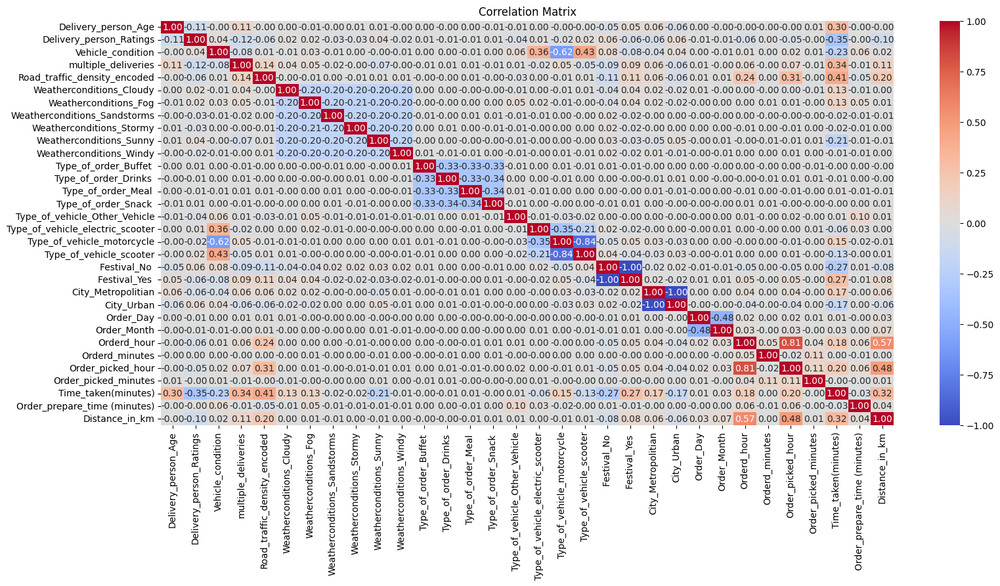

In [200]:
plt.figure(figsize=(18,8))
sns.heatmap(df1.corr(numeric_only=True), annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.show()

### Selecting best features using Feature Selection Technique

In [201]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40595 entries, 0 to 45592
Data columns (total 32 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Delivery_person_Age               40595 non-null  int64  
 1   Delivery_person_Ratings           40595 non-null  float64
 2   Vehicle_condition                 40595 non-null  int64  
 3   multiple_deliveries               40595 non-null  int64  
 4   Road_traffic_density_encoded      40595 non-null  float64
 5   Weatherconditions_Cloudy          40595 non-null  float64
 6   Weatherconditions_Fog             40595 non-null  float64
 7   Weatherconditions_Sandstorms      40595 non-null  float64
 8   Weatherconditions_Stormy          40595 non-null  float64
 9   Weatherconditions_Sunny           40595 non-null  float64
 10  Weatherconditions_Windy           40595 non-null  float64
 11  Type_of_order_Buffet              40595 non-null  float64
 12  Type_of_o

In [202]:
cols_to_drop = ['Time_taken(minutes)', 'Order_prepare_time (minutes)']
X = df1.drop(cols_to_drop, axis=1)
y = df1['Time_taken(minutes)']

In [203]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Index: 40595 entries, 0 to 45592
Data columns (total 30 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Delivery_person_Age               40595 non-null  int64  
 1   Delivery_person_Ratings           40595 non-null  float64
 2   Vehicle_condition                 40595 non-null  int64  
 3   multiple_deliveries               40595 non-null  int64  
 4   Road_traffic_density_encoded      40595 non-null  float64
 5   Weatherconditions_Cloudy          40595 non-null  float64
 6   Weatherconditions_Fog             40595 non-null  float64
 7   Weatherconditions_Sandstorms      40595 non-null  float64
 8   Weatherconditions_Stormy          40595 non-null  float64
 9   Weatherconditions_Sunny           40595 non-null  float64
 10  Weatherconditions_Windy           40595 non-null  float64
 11  Type_of_order_Buffet              40595 non-null  float64
 12  Type_of_o

In [204]:
df2.drop(cols_to_drop[1], axis=1, inplace=True)

In [205]:
dk = df2.pop('Distance_in_km')
df2.insert(29, 'Distance_in_km', dk)

In [206]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 10191 entries, 1 to 11398
Data columns (total 30 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Delivery_person_Age               10191 non-null  int64  
 1   Delivery_person_Ratings           10191 non-null  float64
 2   Vehicle_condition                 10191 non-null  int64  
 3   multiple_deliveries               10191 non-null  int64  
 4   Road_traffic_density_encoded      10191 non-null  float64
 5   Weatherconditions_Cloudy          10191 non-null  float64
 6   Weatherconditions_Fog             10191 non-null  float64
 7   Weatherconditions_Sandstorms      10191 non-null  float64
 8   Weatherconditions_Stormy          10191 non-null  float64
 9   Weatherconditions_Sunny           10191 non-null  float64
 10  Weatherconditions_Windy           10191 non-null  float64
 11  Type_of_order_Buffet              10191 non-null  float64
 12  Type_of_o

In [207]:
from sklearn.feature_selection import SelectKBest, f_regression

seletor = SelectKBest(score_func=f_regression, k=10)
X_best = seletor.fit_transform(X, y)

selected_features_sk = X.columns[seletor.get_support()]
print(selected_features_sk)

X_selected_df1 = X[selected_features_sk]
X_selected_df1.head()

Index(['Delivery_person_Age', 'Delivery_person_Ratings', 'Vehicle_condition',
       'multiple_deliveries', 'Road_traffic_density_encoded',
       'Weatherconditions_Sunny', 'Festival_No ', 'Festival_Yes ',
       'Order_picked_hour', 'Distance_in_km'],
      dtype='object')


,Delivery_person_Age,Delivery_person_Ratings,Vehicle_condition,multiple_deliveries,Road_traffic_density_encoded,Weatherconditions_Sunny,Festival_No,Festival_Yes,Order_picked_hour,Distance_in_km
0,37,4.9,2,0,2.0,1.0,1.0,0.0,11,3
1,34,4.5,2,1,3.0,0.0,1.0,0.0,19,20
2,23,4.4,0,1,0.0,0.0,1.0,0.0,8,1
3,38,4.7,0,1,1.0,1.0,1.0,0.0,18,7
4,32,4.6,1,1,2.0,0.0,1.0,0.0,13,6


### Standardizing / Scaling

train data

In [208]:
# importing libraries for model building
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, root_mean_squared_error

In [209]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [210]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [211]:
# scaled data 
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X.columns)
print(X_train_scaled.head())

   Delivery_person_Age  Delivery_person_Ratings  Vehicle_condition  \
0            -0.621410                 0.520297          -1.232303   
1            -1.497865                -0.105373           1.197586   
2             1.306791                 0.207462          -1.232303   
3            -1.322574                 0.833132           1.197586   
4            -0.971992                 0.207462          -0.017358   

   multiple_deliveries  Road_traffic_density_encoded  \
0              0.50713                      1.300746   
1              0.50713                      1.300746   
2              0.50713                     -1.103068   
3             -1.35932                      0.499475   
4             -1.35932                      1.300746   

   Weatherconditions_Cloudy  Weatherconditions_Fog  \
0                 -0.446040               2.180150   
1                  2.241952              -0.458684   
2                 -0.446040               2.180150   
3                 -0.44604

### Model Building

#### Scatterplot for detect relationship between features and target variables

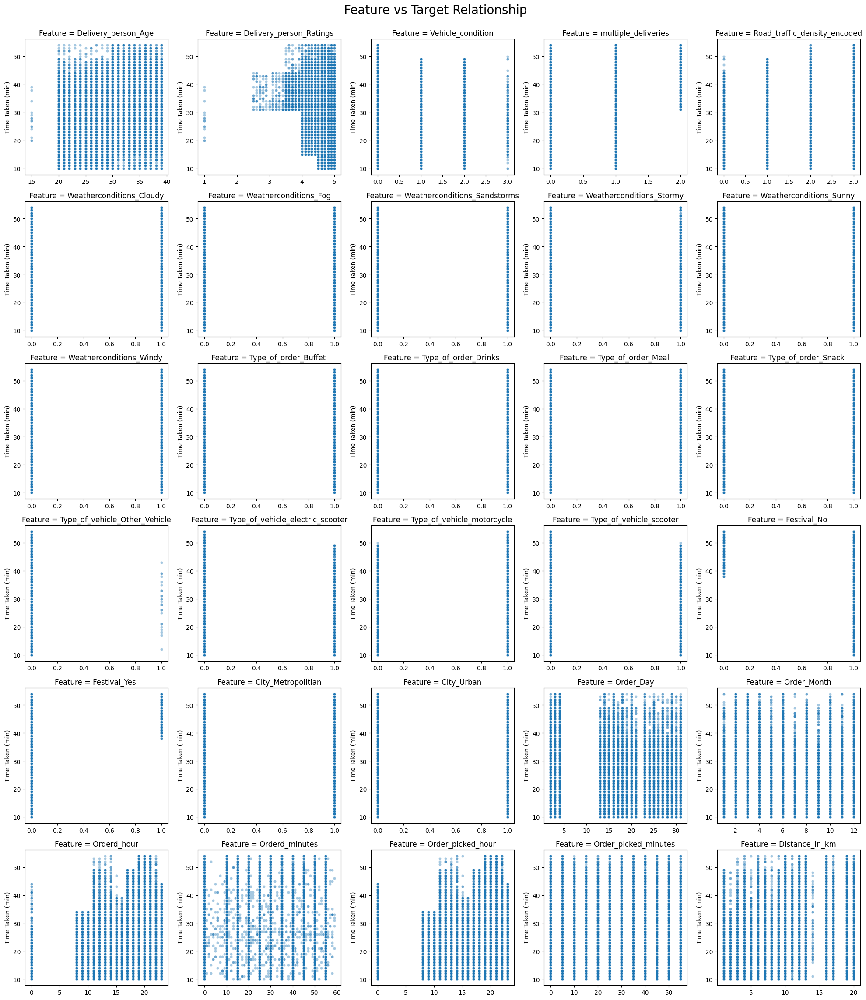

In [212]:
import math

n_cols = 5
n_features = len(X.columns)
n_rows = math.ceil(n_features / n_cols)

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, n_rows * 4))
axes = axes.flatten()

for i, col in enumerate(X.columns):
    ax = axes[i]
    
    sns.scatterplot(x=X[col], y=y, ax=ax, alpha=0.4, s=20)
    ax.set_title(f"Feature = {col}", fontsize=12)
    ax.set_xlabel("") # remove individual x-axis labels to reduce clutter
    ax.set_ylabel("Time Taken (min)") 

for i in range(n_features, len(axes)):
    axes[i].set_visible(False)

fig.suptitle("Feature vs Target Relationship", fontsize=20)
plt.tight_layout(rect=[0, 0.03, 1, 0.98]) 
plt.show()

### Model Evaluation using metrices MAE, MSE, RMSE, R2 Score

In [213]:
def evaluate(true, predicted):
    mae = mean_absolute_error(true, predicted)
    mse = mean_squared_error(true, predicted)
    rmse = root_mean_squared_error(true, predicted)
    r2_square = r2_score(true, predicted)
    print('MAE:', mae)
    print('MSE:', mse)
    print('RMSE:', rmse)
    print('R2 Square', r2_square)
    print('__________________________________')
    return mae, mse, rmse, r2_square

In [214]:
# Initialize an empty DataFrame to store results from all models
results_df = pd.DataFrame(columns=['Model', 'MAE', 'MSE', 'RMSE', 'R2 Square'])

### 1. Linear Regression

In [215]:
print("Linear Regression")
lr_model = LinearRegression()
lr_model.fit(X_train_scaled, y_train)

Linear Regression


,fit_intercept,True
,copy_X,True
,tol,1e-06
,n_jobs,None
,positive,False


In [216]:
y_train_pred = lr_model.predict(X_train_scaled)
y_test_pred = lr_model.predict(X_test_scaled)

In [217]:
print("Linear Regression")
print("\nModel Performance on Training Set:")
train_metrics = evaluate(y_train, y_train_pred)

print("Model Performance on Test Set:")
test_metrics = evaluate(y_test, y_test_pred)

Linear Regression

Model Performance on Training Set:
MAE: 4.8466194819981565
MSE: 36.69899329682784
RMSE: 6.05796940375468
R2 Square 0.5689738527331321
__________________________________
Model Performance on Test Set:
MAE: 4.820695579840609
MSE: 36.66971206176918
RMSE: 6.055552168198139
R2 Square 0.5639508274886473
__________________________________


In [218]:
results_df_1 = pd.DataFrame(data=[["Linear Regression", *test_metrics]], 
                       columns=['Model', 'MAE', 'MSE', 'RMSE', 'R2 Square'])

results_df = pd.concat([results_df, results_df_1], ignore_index=True)

### 2. Ridge Regression

In [219]:
param_grid = {'alpha': [0.1, 1.0, 10, 100]}

ridge_model = Ridge()
grid = GridSearchCV(ridge_model, param_grid, cv=5)
grid.fit(X_train_scaled, y_train)
print("Best Ridge alpha:", grid.best_params_)

Best Ridge alpha: {'alpha': 10}


In [220]:
# Best alpha from GridSearchCV
best_alpha = 10
ridge_model = Ridge(alpha=best_alpha, solver='cholesky', random_state=42)

# Train ridge reg model
ridge_model.fit(X_train_scaled, y_train)

# Predict
y_test_pred = ridge_model.predict(X_test_scaled)
y_train_pred = ridge_model.predict(X_train_scaled)

# Evaluate
print("Ridge Regression")
print("\nModel Performance on Training Set:")
train_metrics = evaluate(y_train, y_train_pred)

print("Model Performance on Test Set:")
test_metrics = evaluate(y_test, y_test_pred)

results_df_2 = pd.DataFrame(data=[["Ridge Regression",*test_metrics]], 
                          columns=['Model', 'MAE', 'MSE', 'RMSE', 'R2 Square'])
results_df = pd.concat([results_df, results_df_2], ignore_index=True)

Ridge Regression

Model Performance on Training Set:
MAE: 4.846618797065799
MSE: 36.69899661475742
RMSE: 6.057969677603002
R2 Square 0.5689738137643681
__________________________________
Model Performance on Test Set:
MAE: 4.820639626513978
MSE: 36.6693355350483
RMSE: 6.055521078738666
R2 Square 0.5639553048667296
__________________________________


### 3. Lasso Regression

In [221]:
lasso_param_grid = {'alpha': [0.01, 0.1, 1.0, 10, 100]}

lasso_model = Lasso(max_iter=10000, random_state=42)
lasso_grid = GridSearchCV(lasso_model, lasso_param_grid, cv=5)
lasso_grid.fit(X_train_scaled, y_train)
print(f"Best Lasso alpha: {lasso_grid.best_params_}")

Best Lasso alpha: {'alpha': 0.01}


In [222]:
# Best alpha from GridSearchCV
best_alpha = lasso_grid.best_params_['alpha']
final_lasso_model = Lasso(alpha=best_alpha, max_iter=10000, random_state=42)

# Train lasso reg model
final_lasso_model.fit(X_train_scaled, y_train)

# Predict
y_train_pred_lasso = final_lasso_model.predict(X_train_scaled)
y_test_pred_lasso = final_lasso_model.predict(X_test_scaled)

# Evaluate
print("Lasso Regression")
print("\nModel Performance on Training Set:")
train_metrics_lasso = evaluate(y_train, y_train_pred_lasso)

print("\nModel Performance on Test Set:")
test_metrics_lasso = evaluate(y_test, y_test_pred_lasso)

# Add the test results to results_df 
results_df_3 = pd.DataFrame(data=[["Lasso Regression", *test_metrics_lasso]],
                           columns=['Model', 'MAE', 'MSE', 'RMSE', 'R2 Square'])

results_df = pd.concat([results_df, results_df_3], ignore_index=True)

Lasso Regression

Model Performance on Training Set:
MAE: 4.846734989782859
MSE: 36.702365452356666
RMSE: 6.058247721276893
R2 Square 0.568934247090715
__________________________________

Model Performance on Test Set:
MAE: 4.820161095068087
MSE: 36.6751966771469
RMSE: 6.056005009669898
R2 Square 0.5638856084873918
__________________________________


### 4. Decision Tree

In [223]:
print("\nDecision Tree Regressor with GridSearchCV")

param_grid_dt = {
    'max_depth': [5, 10, 20, None],  # None means the tree grows as deep as it can
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search_dt = GridSearchCV(estimator=DecisionTreeRegressor(random_state=42),
                              param_grid=param_grid_dt,
                              cv=3,
                              n_jobs=-1,
                              verbose=2,
                              scoring='r2')

# train model
grid_search_dt.fit(X_train_scaled, y_train)

# best model and its parameters
print(f"\nBest Parameters found: {grid_search_dt.best_params_}")
best_dt_model = grid_search_dt.best_estimator_

# Predict
y_train_pred_dt = best_dt_model.predict(X_train_scaled)
y_test_pred_dt = best_dt_model.predict(X_test_scaled)

# Evaluate 
print("\nModel Performance on Training Set:")
train_metrics_dt = evaluate(y_train, y_train_pred_dt)

print("\nModel Performance on Test Set:")
test_metrics_dt = evaluate(y_test, y_test_pred_dt)

# Add the test results to test df
results_df_7 = pd.DataFrame(data=[["Decision Tree", *test_metrics_dt]],
                          columns=['Model', 'MAE', 'MSE', 'RMSE', 'R2 Square'])

results_df = pd.concat([results_df, results_df_7], ignore_index=True)


Decision Tree Regressor with GridSearchCV
Fitting 3 folds for each of 36 candidates, totalling 108 fits

Best Parameters found: {'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 10}

Model Performance on Training Set:
MAE: 2.998362739355873
MSE: 14.444251536319742
RMSE: 3.800559371503061
R2 Square 0.830353654676637
__________________________________

Model Performance on Test Set:
MAE: 3.2437644324623838
MSE: 16.57413502902886
RMSE: 4.071134366368772
R2 Square 0.8029126093947634
__________________________________


### 5. Random Forest

In [224]:
print("\Random Forest")
rf = RandomForestRegressor(random_state=42)

param_grid_rf = {
    'n_estimators': [100, 200],
    'max_depth': [10, 20],
    'min_samples_split': [2],
    'min_samples_leaf': [1]
}

grid_search_rf = GridSearchCV(estimator=rf, param_grid=param_grid_rf, 
                    cv=3, n_jobs=-1, verbose=2, scoring='r2')

# Train random forest model
grid_search_rf.fit(X_train_scaled, y_train)

# best model
print(f"\nBest Parameters found: {grid_search_rf.best_params_}")
best_rf_model = grid_search_rf.best_estimator_

# Predict
y_train_pred_rf = best_rf_model.predict(X_train_scaled)
y_test_pred_rf = best_rf_model.predict(X_test_scaled)

# Evaluate
print("\nModel Performance on Training Set:")
train_metrics_rf = evaluate(y_train, y_train_pred_rf)

print("\nModel Performance on Test Set:")
test_metrics_rf = evaluate(y_test, y_test_pred_rf)

# Add the test results to results df
results_df_4 = pd.DataFrame(data=[["Random Forest", *test_metrics_rf]], 
                          columns=['Model', 'MAE', 'MSE', 'RMSE', 'R2 Square'])

results_df = pd.concat([results_df, results_df_4], ignore_index=True)

\Random Forest
Fitting 3 folds for each of 4 candidates, totalling 12 fits

Best Parameters found: {'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}

Model Performance on Training Set:
MAE: 2.9234190687470547
MSE: 13.463538085169915
RMSE: 3.669269421174999
R2 Square 0.8418720398542066
__________________________________

Model Performance on Test Set:
MAE: 3.163524369116692
MSE: 15.534822088593517
RMSE: 3.9414238656345395
R2 Square 0.8152713524057198
__________________________________


### 6. XGBoost

In [225]:
print("XGBoost Regressor with GridSearchCV")

#hyperparameter grid for XGBoost
param_grid_xgb = {
    'n_estimators': [100, 200],         
    'max_depth': [5, 7],                
    'learning_rate': [0.1, 0.2],        
    'subsample': [0.8],                 # Fraction of samples to be used for fitting each tree
    'colsample_bytree': [0.8]           # Fraction of features to be used for fitting each tree
}


grid_search_xgb = GridSearchCV(estimator=XGBRegressor(objective='reg:squarederror', random_state=42),
                               param_grid=param_grid_xgb,
                               cv=3,
                               n_jobs=-1,
                               verbose=2,
                               scoring='r2')

#  train xgb model
grid_search_xgb.fit(X_train_scaled, y_train)

# best model and print its parameters
print(f"\nBest Parameters found: {grid_search_xgb.best_params_}")
best_xgb_model = grid_search_xgb.best_estimator_

# Predict
y_train_pred_xgb = best_xgb_model.predict(X_train_scaled)
y_test_pred_xgb = best_xgb_model.predict(X_test_scaled)

# Evaluate 
print("\nModel Performance on Training Set:")
train_metrics_xgb = evaluate(y_train, y_train_pred_xgb)

print("\nModel Performance on Test Set:")
test_metrics_xgb = evaluate(y_test, y_test_pred_xgb)

# Add the test results to test df
results_df_5 = pd.DataFrame(data=[["XGBoost", *test_metrics_xgb]],
                           columns=['Model', 'MAE', 'MSE', 'RMSE', 'R2 Square'])

results_df = pd.concat([results_df, results_df_5], ignore_index=True)

XGBoost Regressor with GridSearchCV
Fitting 3 folds for each of 8 candidates, totalling 24 fits

Best Parameters found: {'colsample_bytree': 0.8, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 100, 'subsample': 0.8}

Model Performance on Training Set:
MAE: 2.7599680423736572
MSE: 11.849204063415527
RMSE: 3.4422671794891357
R2 Square 0.8608322143554688
__________________________________

Model Performance on Test Set:
MAE: 3.1259849071502686
MSE: 15.178129196166992
RMSE: 3.895911931991577
R2 Square 0.8195129036903381
__________________________________


### 7. LightGBM 

In [226]:
print("LightGBM Regressor with GridSearchCV")

# 'num_leaves' is a key parameter for LGBM that controls model complexity.
param_grid_lgbm = {
    'n_estimators': [100, 200],
    'max_depth': [5, 7],
    'learning_rate': [0.1, 0.2],
    'num_leaves': [31, 50]  # Should be less than 2^max_depth
}

grid_search_lgbm = GridSearchCV(estimator=LGBMRegressor(objective='regression', random_state=42),
                                param_grid=param_grid_lgbm,
                                cv=3,
                                n_jobs=-1,
                                verbose=2,
                                scoring='r2')

# train model
grid_search_lgbm.fit(X_train_scaled, y_train)

# best model and its parameters
print(f"\nBest Parameters found: {grid_search_lgbm.best_params_}")
best_lgbm_model = grid_search_lgbm.best_estimator_

# Predict
y_train_pred_lgbm = best_lgbm_model.predict(X_train_scaled)
y_test_pred_lgbm = best_lgbm_model.predict(X_test_scaled)

# Evaluate 
print("\nModel Performance on Training Set:")
train_metrics_lgbm = evaluate(y_train, y_train_pred_lgbm)

print("\nModel Performance on Test Set:")
test_metrics_lgbm = evaluate(y_test, y_test_pred_lgbm)

# Add the test results to test df
results_df_6 = pd.DataFrame(data=[["LightGBM", *test_metrics_lgbm]],
                            columns=['Model', 'MAE', 'MSE', 'RMSE', 'R2 Square'])

results_df = pd.concat([results_df, results_df_6], ignore_index=True)

LightGBM Regressor with GridSearchCV
Fitting 3 folds for each of 16 candidates, totalling 48 fits
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001347 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 279
[LightGBM] [Info] Number of data points in the train set: 32476, number of used features: 29
[LightGBM] [Info] Start training from score 26.204551
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

Best Parameters found: {'learning_rate':

In [227]:
# Comparison table ---
print("\nModel Comparison Table")
print(results_df.sort_values(by='R2 Square', ascending=False))


Model Comparison Table
               Model       MAE        MSE      RMSE  R2 Square
6           LightGBM  3.107256  14.895811  3.859509   0.822870
5            XGBoost  3.125985  15.178129  3.895912   0.819513
4      Random Forest  3.163524  15.534822  3.941424   0.815271
3      Decision Tree  3.243764  16.574135  4.071134   0.802913
1   Ridge Regression  4.820640  36.669336  6.055521   0.563955
0  Linear Regression  4.820696  36.669712  6.055552   0.563951
2   Lasso Regression  4.820161  36.675197  6.056005   0.563886


### Fill Target Variable on Test data

In [228]:
final_model = best_lgbm_model

scaler_final =StandardScaler()
X_full_scaled = scaler_final.fit_transform(X)

print("Training LightGBM model on whole train data")
final_model.fit(X_full_scaled, y)

Training LightGBM model on whole train data
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001820 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 282
[LightGBM] [Info] Number of data points in the train set: 40595, number of used features: 30
[LightGBM] [Info] Start training from score 26.166597
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

,boosting_type,'gbdt'
,num_leaves,50
,max_depth,7
,learning_rate,0.1
,n_estimators,100
,subsample_for_bin,200000
,objective,'regression'
,class_weight,None
,min_split_gain,0.0
,min_child_weight,0.001
,min_child_samples,20


In [229]:
test_data_scaled = scaler_final.transform(df2)
print("Making Final predictions on the test set")
final_predictions = final_model.predict(test_data_scaled)

Making Final predictions on the test set


In [230]:
final_df = df2.copy()
final_df['Time_taken(minutes)'] = final_predictions.round(0).astype(int)

print(final_df.head())

   Delivery_person_Age  Delivery_person_Ratings  Vehicle_condition  \
1                   28                      4.6                  0   
2                   23                      4.5                  0   
3                   21                      4.8                  1   
4                   31                      4.6                  2   
5                   26                      4.7                  0   

   multiple_deliveries  Road_traffic_density_encoded  \
1                    1                           3.0   
2                    1                           3.0   
3                    1                           1.0   
4                    1                           1.0   
5                    1                           0.0   

   Weatherconditions_Cloudy  Weatherconditions_Fog  \
1                       0.0                    0.0   
2                       0.0                    0.0   
3                       0.0                    1.0   
4                       0.

In [231]:
final_df.describe()

,Delivery_person_Age,Delivery_person_Ratings,Vehicle_condition,multiple_deliveries,Road_traffic_density_encoded,Weatherconditions_Cloudy,Weatherconditions_Fog,Weatherconditions_Sandstorms,Weatherconditions_Stormy,Weatherconditions_Sunny,...,City_Metropolitian,City_Urban,Order_Day,Order_Month,Orderd_hour,Orderd_minutes,Order_picked_hour,Order_picked_minutes,Distance_in_km,Time_taken(minutes)
count,10191.000000,10191.000000,10191.000000,10191.000000,10191.000000,10191.000000,10191.000000,10191.000000,10191.000000,10191.000000,...,10191.000000,10191.000000,10191.000000,10191.000000,10191.000000,10191.000000,10191.000000,10191.000000,10191.000000,10191.000000
mean,29.484545,4.636866,1.017761,0.730939,1.366598,0.167108,0.161515,0.166912,0.160338,0.173683,...,0.773722,0.226278,12.627613,4.243548,17.475027,29.363065,17.233245,28.720930,9.284957,26.073496
std,5.685073,0.327008,0.824180,0.537891,1.245616,0.373091,0.368023,0.372916,0.366937,0.378855,...,0.418442,0.418442,9.692990,2.896845,4.825141,16.547872,5.312664,17.480404,5.545304,8.306529
min,15.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,2.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,12.000000
25%,25.000000,4.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,0.000000,3.000000,3.000000,15.000000,15.000000,14.000000,15.000000,4.000000,20.000000
50%,30.000000,4.700000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,0.000000,13.000000,3.000000,19.000000,30.000000,19.000000,30.000000,9.000000,24.000000
75%,34.000000,4.900000,2.000000,1.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,0.000000,20.000000,5.000000,21.000000,45.000000,21.000000,45.000000,13.000000,32.000000
max,39.000000,5.000000,3.000000,2.000000,3.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,31.000000,12.000000,23.000000,58.000000,23.000000,55.000000,20.000000,50.000000


In [232]:
ON_TIME_THRESHOLD_MINUTES = 30

final_df['Delivery_Status'] = np.where(final_df['Time_taken(minutes)'] <= ON_TIME_THRESHOLD_MINUTES, 'On-Time', 'Late')
final_df['Time_Difference(min)'] = (final_df['Time_taken(minutes)'] - ON_TIME_THRESHOLD_MINUTES).abs()

In [233]:
ON_TIME_THRESHOLD_MINUTES = 30

df1['Delivery_Status'] = np.where(df1['Time_taken(minutes)'] <= ON_TIME_THRESHOLD_MINUTES, 'On-Time', 'Late')
df1['Time_Difference(min)'] = (df1['Time_taken(minutes)'] - ON_TIME_THRESHOLD_MINUTES).abs()

In [237]:
df1['Delivery_Status'].value_counts()

Delivery_Status
On-Time    28628
Late       11967
Name: count, dtype: int64

### Final Results

In [234]:
final_df.tail(20)

,Delivery_person_Age,Delivery_person_Ratings,Vehicle_condition,multiple_deliveries,Road_traffic_density_encoded,Weatherconditions_Cloudy,Weatherconditions_Fog,Weatherconditions_Sandstorms,Weatherconditions_Stormy,Weatherconditions_Sunny,...,Order_Day,Order_Month,Orderd_hour,Orderd_minutes,Order_picked_hour,Order_picked_minutes,Distance_in_km,Time_taken(minutes),Delivery_Status,Time_Difference(min)
11376,31,4.8,2,0,0.0,1.0,0.0,0.0,0.0,0.0,...,24,3,23,40,23,50,9,17,On-Time,13
11377,34,4.8,1,1,0.0,0.0,0.0,0.0,0.0,1.0,...,3,7,22,40,22,45,7,16,On-Time,14
11378,21,4.7,1,1,3.0,0.0,0.0,0.0,0.0,0.0,...,29,3,21,15,21,30,10,23,On-Time,7
11379,22,4.6,0,1,3.0,0.0,0.0,0.0,0.0,1.0,...,3,10,21,15,21,30,16,26,On-Time,4
11380,33,4.0,0,0,1.0,0.0,0.0,1.0,0.0,0.0,...,18,3,17,45,18,0,10,39,Late,9
11381,36,4.5,2,1,1.0,1.0,0.0,0.0,0.0,0.0,...,24,3,17,30,17,40,7,18,On-Time,12
11382,21,5.0,2,1,0.0,0.0,0.0,0.0,1.0,0.0,...,19,3,9,50,10,5,1,16,On-Time,14
11384,37,4.8,0,0,3.0,1.0,0.0,0.0,0.0,0.0,...,15,2,20,30,20,40,9,28,On-Time,2
11385,21,5.0,2,1,1.0,0.0,0.0,0.0,0.0,0.0,...,19,3,17,35,17,45,9,25,On-Time,5
11386,38,4.0,0,0,3.0,0.0,0.0,0.0,0.0,0.0,...,24,3,21,30,21,45,4,39,Late,9


In [235]:
final_df['Delivery_Status'].value_counts()

Delivery_Status
On-Time    7384
Late       2807
Name: count, dtype: int64

In [238]:
# final_df.to_csv('Final_test_data_with_Predictions.csv', index=False)